Copyright (c) 2020 Ryan Cohn and Elizabeth Holm. All rights reserved. <br />
Licensed under the MIT License (see LICENSE for details) <br />
Written by Ryan Cohn

# Instance Segmentation of Powder Particles and Satellites

This example will take you through the process of training a model to segment powder particles and visualizing the model predictions.

In [11]:
## regular module imports
import cv2
import json
import matplotlib.pyplot as plt
import numpy as np
import os
from pathlib import Path
import pickle
import skimage.io
import sys

## detectron2
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.data import (
    DatasetCatalog,
    MetadataCatalog,
)
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.structures import BoxMode

root = '../../../'
ocean_images = root + '../../../../ocean/projects/dmr200021p/sprice/tuning/'
sys.path.append(root)

from ampis import data_utils, visualize, analyze
from ampis.applications import powder
from ampis.structures import InstanceSet
from ampis.visualize import display_iset



import random
random.seed(1)
%matplotlib inline

# Labeling Data

The [VGG Image Annotator](http://www.robots.ox.ac.uk/~vgg/software/via/) was used to generate particle labels. The a

# Loading Data
The process for training models for powder particles and satellites is identical. Enter the corresponding value depending on which model you want to train. <br />
The paths to individual images, and all annotation data are stored in the JSON files generated by the VGG image annotator.



In [12]:
EXPERIMENT_NAME = 'satellite' # can be 'particle' or 'satellite'
json_path_train = Path('batch_jobs', 'SALAS_Rep', 'satellite_training.json')  # path to training data
json_path_val = Path('batch_jobs', 'SALAS_Rep', 'satellite_validation.json')  # path to training data
assert json_path_train.is_file(), 'training file not found!'
assert json_path_val.is_file(), 'validation file not found!'


## Registration
Detectron2 requires that datasets be registered for later use.
Registration stores the name of the dataset and a function that can be used to retrieve the image paths and labels in a format that the model can use.

In [13]:
DatasetCatalog.clear()  # resets catalog, helps prevent errors from running cells multiple times

# store names of datasets that will be registered for easier access later
dataset_train = f'{EXPERIMENT_NAME}_Train'
dataset_valid = f'{EXPERIMENT_NAME}_Val'

# register the training dataset
DatasetCatalog.register(dataset_train, lambda f = json_path_train: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                     im_root=f,  # path to the training data json file
                                                                                                     dataset_class='Train'))  # indicates this is training data
# register the validation dataset
DatasetCatalog.register(dataset_valid, lambda f = json_path_val: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                im_root=f,  # path to validation data json file
                                                                                                dataset_class='Validation'))  # indicates this is validation data
                              
print(f'Registered Datasets: {DatasetCatalog.list()}')

## There is also a metadata catalog, which stores the class names.
for d in [dataset_train, dataset_valid]:
    MetadataCatalog.get(d).set(**{'thing_classes': [EXPERIMENT_NAME]})

Registered Datasets: ['satellite_Train', 'satellite_Val']


## Verify images and annotations are loaded correctly
Also, this is a great time to admire my hand-drawn labels, which took sooooo long to do!
### Training Data

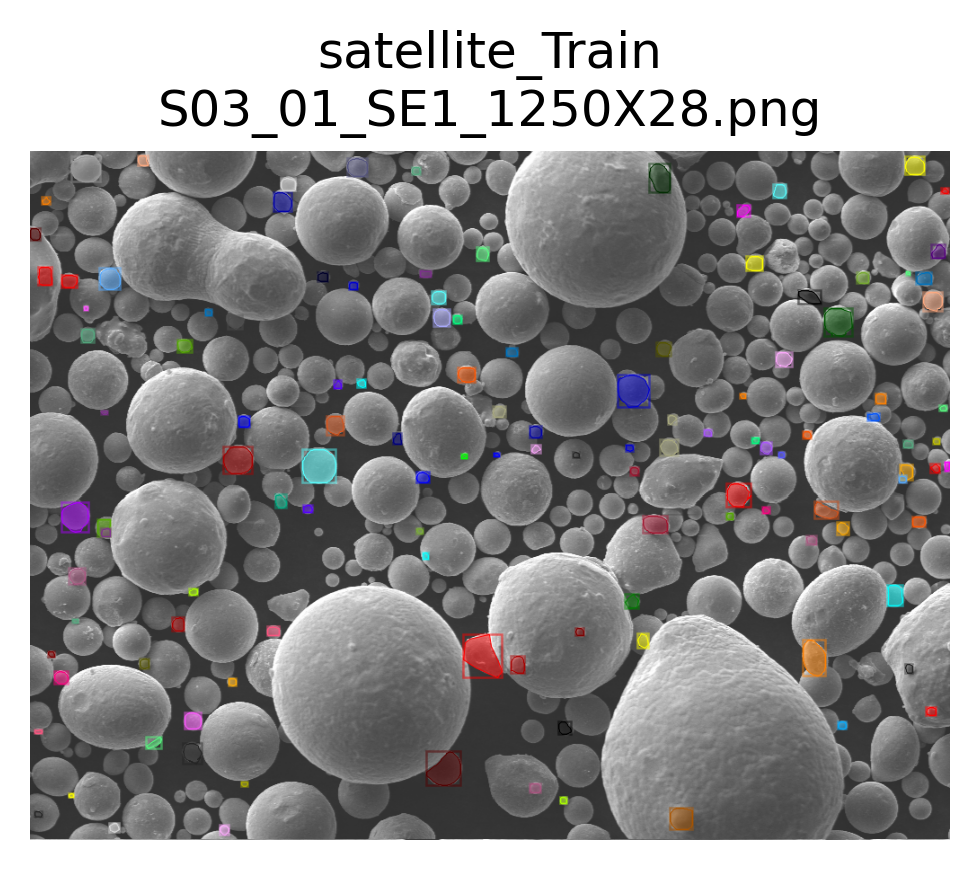

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_01_SE1_1250X28.png
	num_instances: 123


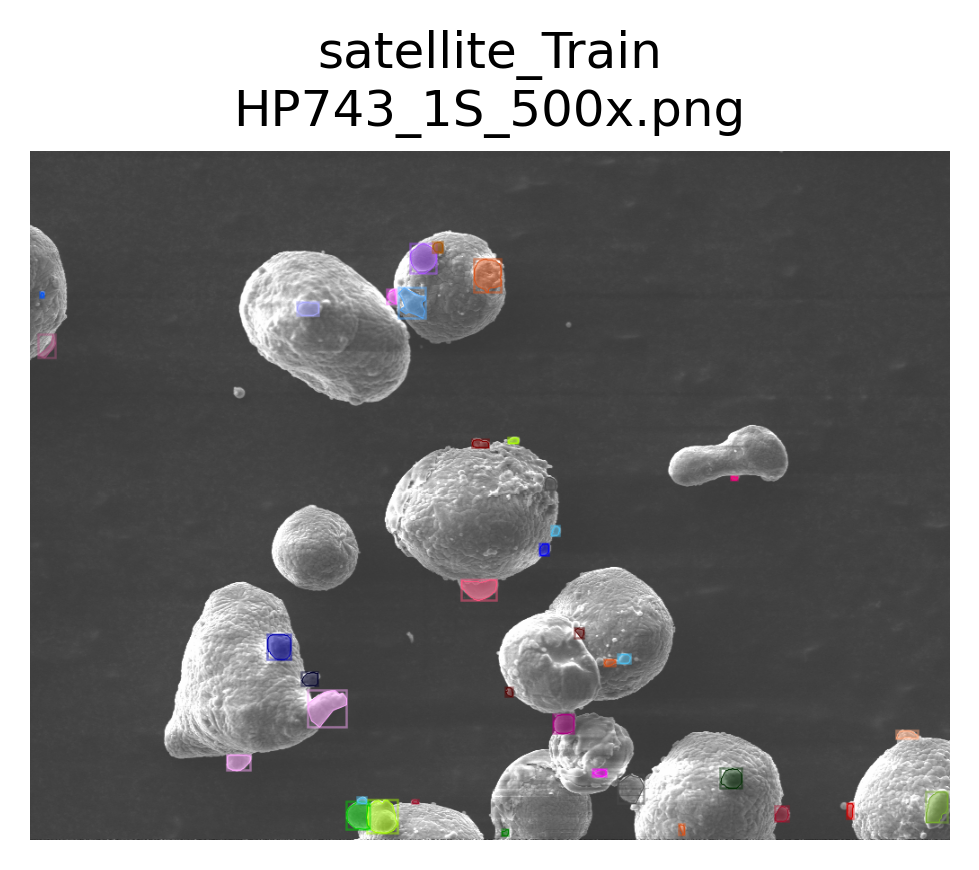

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_1S_500x.png
	num_instances: 37


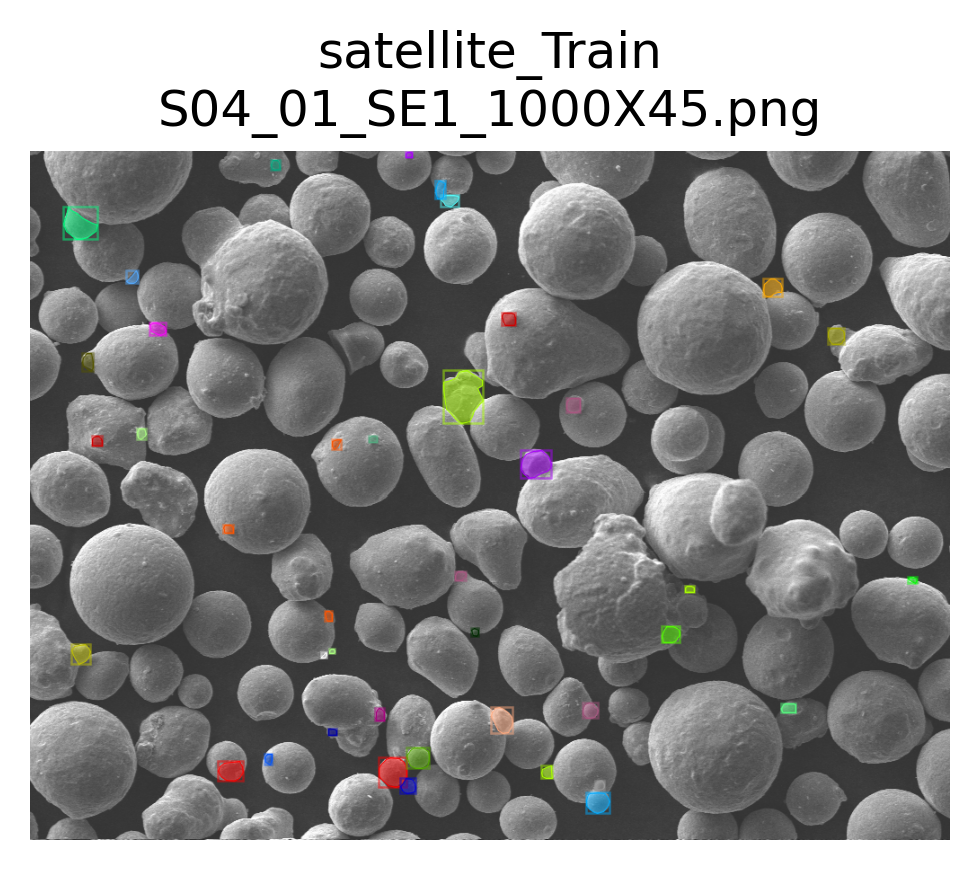

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png
	num_instances: 41


In [14]:
for i in np.random.choice(DatasetCatalog.get(dataset_train), 3, replace=False):
    visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)
#To view annotations on the entire dataset and not just 3 random instances, uncomment the following code
#for i in DatasetCatalog.get(dataset_train):
    #visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)

### Validation Data

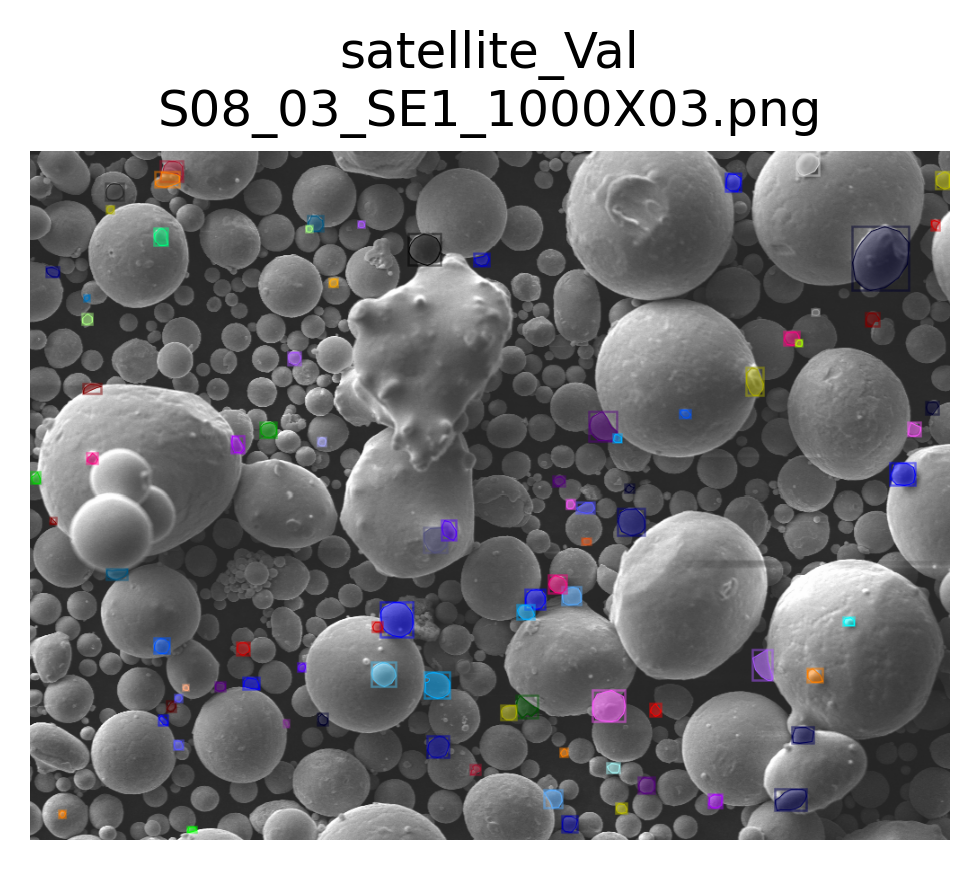

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png
	num_instances: 88


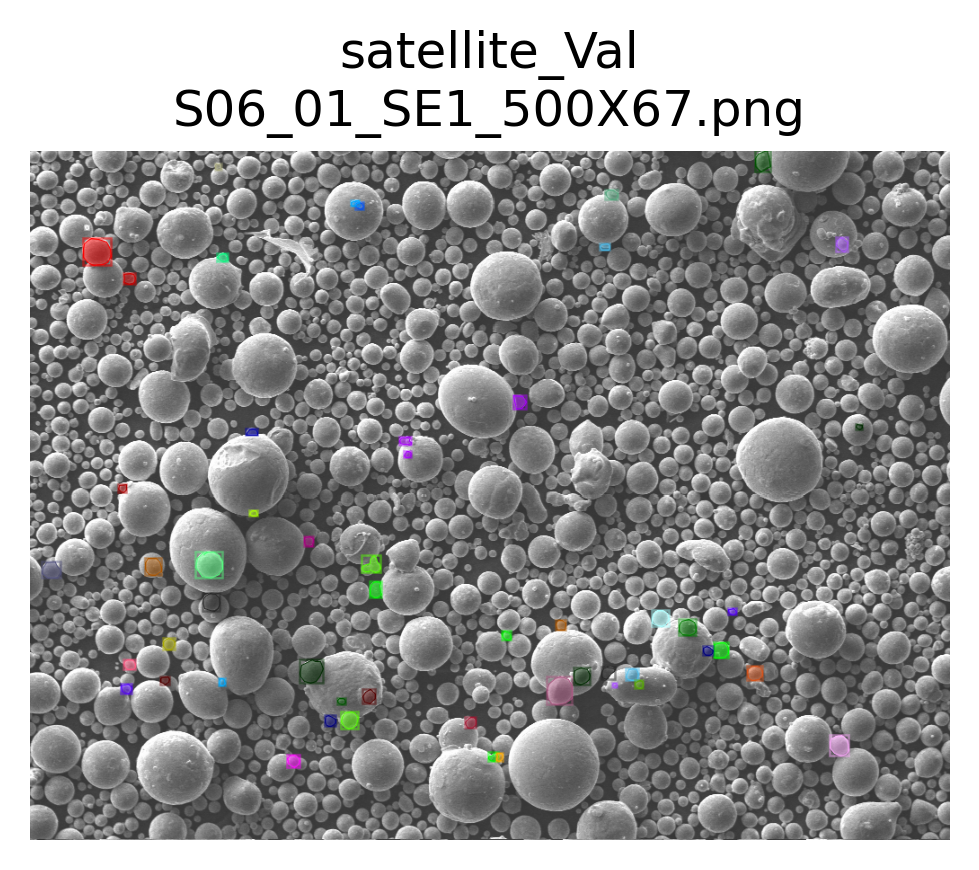

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png
	num_instances: 54


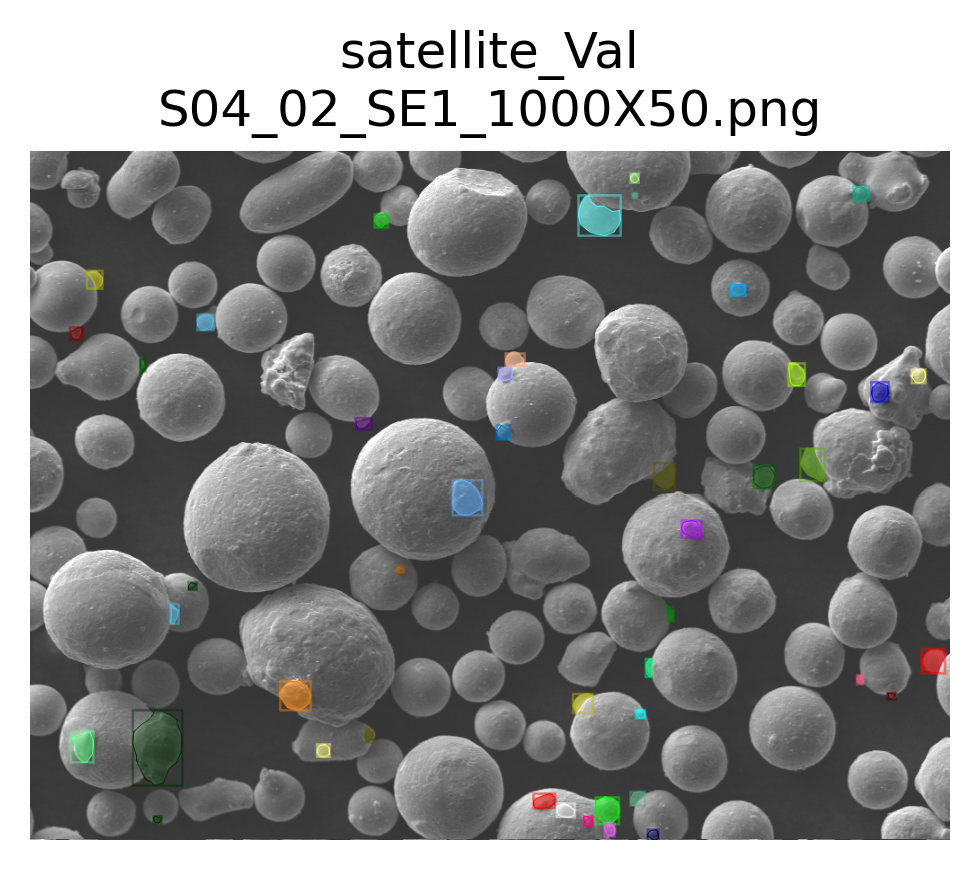

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png
	num_instances: 45


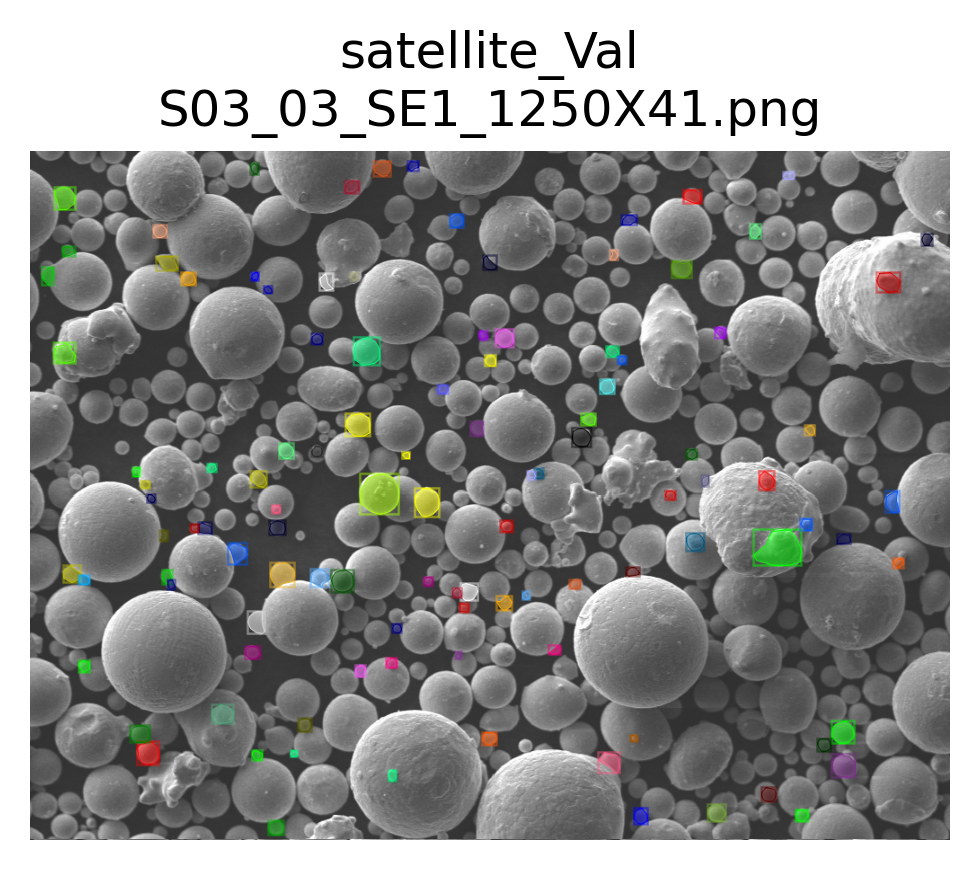

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png
	num_instances: 111


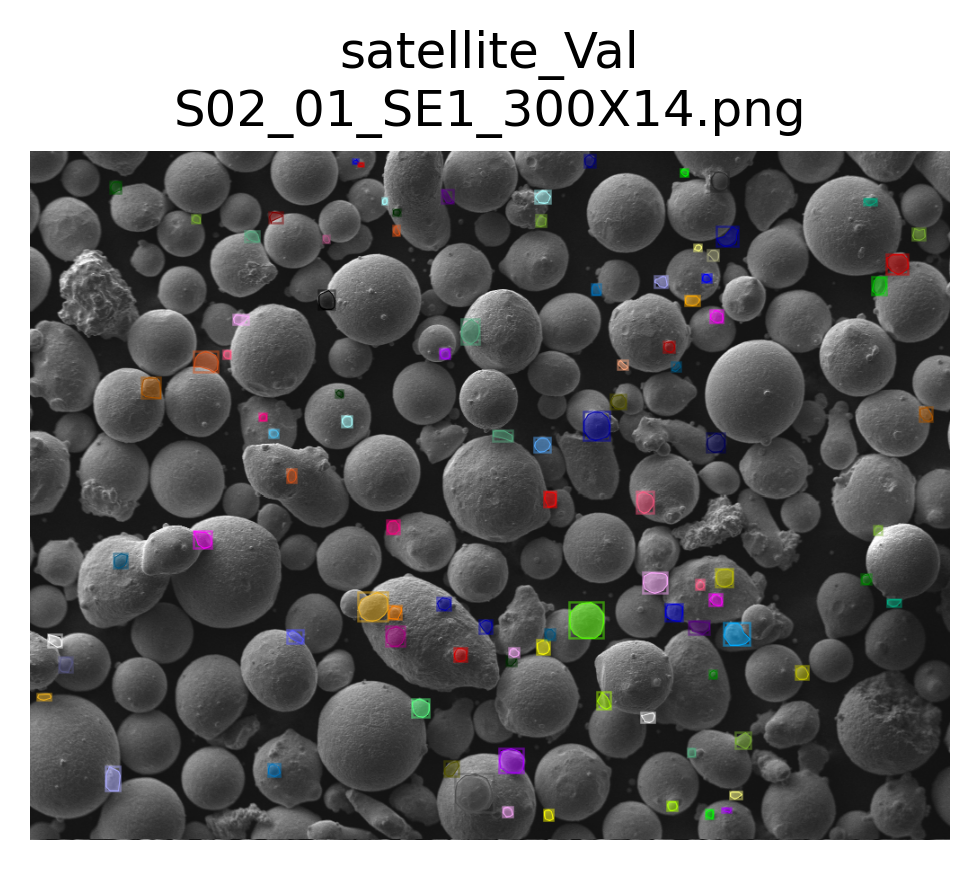

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png
	num_instances: 98


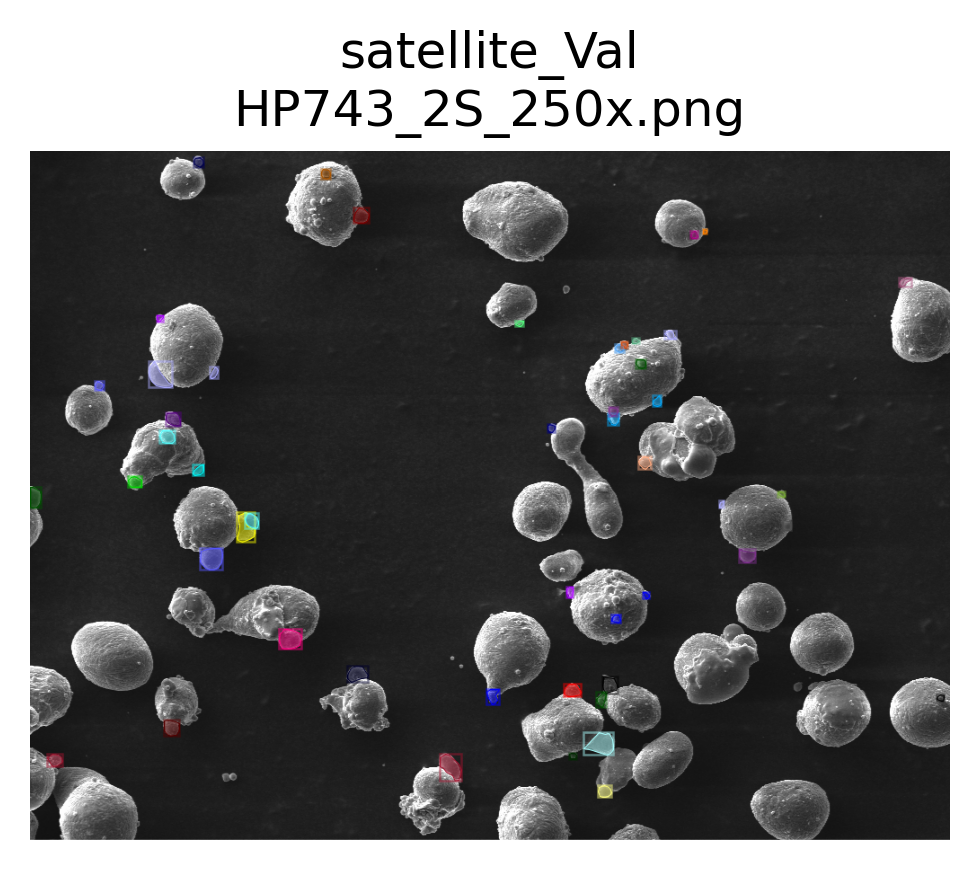

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png
	num_instances: 49


In [15]:
for i in DatasetCatalog.get(dataset_valid):
    visualize.display_ddicts(i, None, dataset_valid, suppress_labels=True)

## Model Configuration
This is where we specify the directory where the outputs are saved, various hyperparameters for the model, and more.

In [16]:
cfg = get_cfg() # initialize cfg object
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'))  # load default parameters for Mask R-CNN
cfg.INPUT.MASK_FORMAT = 'polygon'  # masks generated in VGG image annotator are polygons
cfg.DATASETS.TRAIN = (dataset_train,)  # dataset used for training model
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # we will look at the predictions on both sets after training
cfg.SOLVER.IMS_PER_BATCH = 1 # number of images per batch (across all machines)
cfg.SOLVER.CHECKPOINT_PERIOD = 1000  # number of iterations after which to save model checkpoints
cfg.MODEL.DEVICE='cuda'  # 'cpu' to force model to run on cpu, 'cuda' if you have a compatible gpu
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 # Since we are training separate models for particles and satellites there is only one class output
cfg.TEST.DETECTIONS_PER_IMAGE = 400 if EXPERIMENT_NAME == 'particle' else 250  # maximum number of instances that can be detected in an image (this is fixed in mask r-cnn)
cfg.SOLVER.MAX_ITER = 5000  # maximum number of iterations to run during training
                            # Increasing this may improve the training results, but will take longer to run (especially without a gpu!)
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.PANOPTIC_FPN.COMBINE.INSTANCES_CONFIDENCE_THRESH = 0.5
# model weights will be downloaded if they are not present
weights_path = Path('..','models','model_final_f10217.pkl')
if weights_path.is_file():
    print('Using locally stored weights: {}'.format(weights_path))
else:
    weights_path = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
    print('Weights not found, weights will be downloaded from source: {}'.format(weights_path))
cfg.MODEL.WEIGHTs = str(weights_path)
cfg.OUTPUT_DIR = str(Path('DEMO_TEST'))
# make the output directory
os.makedirs(Path(cfg.OUTPUT_DIR), exist_ok=True)
cfg.SEED = 1

Weights not found, weights will be downloaded from source: https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl


In [17]:
print('--------------------------------')
print(cfg.SOLVER.BASE_LR)
print(cfg.SOLVER.WEIGHT_DECAY)
print(cfg.MODEL.RETINANET.SCORE_THRESH_TEST)
print(cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST)
print(cfg.MODEL.PANOPTIC_FPN.COMBINE.INSTANCES_CONFIDENCE_THRESH)
print(cfg.MODEL.ROI_HEADS.NUM_CLASSES)
print(cfg.SOLVER.IMS_PER_BATCH) 

--------------------------------
0.02
0.0001
0.5
0.5
0.5
1
1


# Model Training
Once we have everything set up, training is very easy!

Note- this block will generate a huge wall of text.

In [18]:
trainer = DefaultTrainer(cfg)  # create trainer object from cfg
trainer.resume_or_load(resume=False)  # start training from iteration 0
trainer.train()  # train the model!

[09/17 13:03:00 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[09/17 13:03:00 d2.data.build]: Removed 0 images with no usable annotations. 20 images left.
[09/17 13:03:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[09/17 13:03:00 d2.data.build]: Using training sampler TrainingSampler
[09/17 13:03:00 d2.data.common]: Serializing 20 elements to byte tensors and concatenating them all ...
[09/17 13:03:00 d2.data.common]: Serialized dataset takes 0.46 MiB
WARNING [09/17 13:03:00 d2.solver.build]: SOLVER.STEPS contains values larger than SOLVER.MAX_ITER. These values will be ignored.
[09/17 13:03:01 d2.checkpoint.c2_model_loading]: Renaming Caffe2 weights ......
[09/17 13:03:01 d2.checkpoint.c2_model_loading]: Following weights matched with submodule backbone.bottom_up:
| Names in Model    | Names in Checkpoint      | Shapes                                          |
|:------------------|:------------

[09/17 13:03:30 d2.utils.events]:  eta: 0:13:12  iter: 159  total_loss: 1.87  loss_cls: 0.2794  loss_box_reg: 0.4308  loss_mask: 0.3936  loss_rpn_cls: 0.2826  loss_rpn_loc: 0.4549  time: 0.1703  data_time: 0.0183  lr: 0.0031968  max_mem: 1991M
[09/17 13:03:33 d2.utils.events]:  eta: 0:13:06  iter: 179  total_loss: 1.794  loss_cls: 0.2718  loss_box_reg: 0.429  loss_mask: 0.3454  loss_rpn_cls: 0.3161  loss_rpn_loc: 0.4927  time: 0.1693  data_time: 0.0175  lr: 0.0035964  max_mem: 1991M
[09/17 13:03:36 d2.utils.events]:  eta: 0:13:01  iter: 199  total_loss: 1.91  loss_cls: 0.284  loss_box_reg: 0.475  loss_mask: 0.4035  loss_rpn_cls: 0.2779  loss_rpn_loc: 0.4401  time: 0.1690  data_time: 0.0186  lr: 0.003996  max_mem: 1991M
[09/17 13:03:40 d2.utils.events]:  eta: 0:12:55  iter: 219  total_loss: 1.817  loss_cls: 0.2571  loss_box_reg: 0.4899  loss_mask: 0.3423  loss_rpn_cls: 0.225  loss_rpn_loc: 0.4954  time: 0.1682  data_time: 0.0180  lr: 0.0043956  max_mem: 1991M
[09/17 13:03:43 d2.utils.ev

[09/17 13:05:19 d2.utils.events]:  eta: 0:11:25  iter: 819  total_loss: 1.571  loss_cls: 0.2464  loss_box_reg: 0.4505  loss_mask: 0.2203  loss_rpn_cls: 0.1439  loss_rpn_loc: 0.4564  time: 0.1656  data_time: 0.0178  lr: 0.016384  max_mem: 1991M
[09/17 13:05:22 d2.utils.events]:  eta: 0:11:22  iter: 839  total_loss: 1.432  loss_cls: 0.2072  loss_box_reg: 0.362  loss_mask: 0.2436  loss_rpn_cls: 0.1798  loss_rpn_loc: 0.4181  time: 0.1656  data_time: 0.0181  lr: 0.016783  max_mem: 1991M
[09/17 13:05:25 d2.utils.events]:  eta: 0:11:19  iter: 859  total_loss: 1.484  loss_cls: 0.2119  loss_box_reg: 0.4152  loss_mask: 0.2387  loss_rpn_cls: 0.2068  loss_rpn_loc: 0.4283  time: 0.1656  data_time: 0.0189  lr: 0.017183  max_mem: 1991M
[09/17 13:05:29 d2.utils.events]:  eta: 0:11:15  iter: 879  total_loss: 1.538  loss_cls: 0.2201  loss_box_reg: 0.4161  loss_mask: 0.2499  loss_rpn_cls: 0.1867  loss_rpn_loc: 0.4493  time: 0.1655  data_time: 0.0173  lr: 0.017582  max_mem: 1991M
[09/17 13:05:32 d2.utils.

[09/17 13:07:09 d2.utils.events]:  eta: 0:09:37  iter: 1479  total_loss: 1.372  loss_cls: 0.2171  loss_box_reg: 0.4078  loss_mask: 0.2096  loss_rpn_cls: 0.1622  loss_rpn_loc: 0.3739  time: 0.1651  data_time: 0.0183  lr: 0.02  max_mem: 1991M
[09/17 13:07:12 d2.utils.events]:  eta: 0:09:33  iter: 1499  total_loss: 1.382  loss_cls: 0.2134  loss_box_reg: 0.4023  loss_mask: 0.2108  loss_rpn_cls: 0.1706  loss_rpn_loc: 0.3878  time: 0.1650  data_time: 0.0175  lr: 0.02  max_mem: 1991M
[09/17 13:07:15 d2.utils.events]:  eta: 0:09:30  iter: 1519  total_loss: 1.387  loss_cls: 0.2092  loss_box_reg: 0.3752  loss_mask: 0.1945  loss_rpn_cls: 0.1517  loss_rpn_loc: 0.3802  time: 0.1650  data_time: 0.0187  lr: 0.02  max_mem: 1991M
[09/17 13:07:19 d2.utils.events]:  eta: 0:09:27  iter: 1539  total_loss: 1.375  loss_cls: 0.1938  loss_box_reg: 0.3897  loss_mask: 0.1948  loss_rpn_cls: 0.1618  loss_rpn_loc: 0.3922  time: 0.1651  data_time: 0.0175  lr: 0.02  max_mem: 1991M
[09/17 13:07:22 d2.utils.events]:  e

[09/17 13:09:02 d2.utils.events]:  eta: 0:07:53  iter: 2139  total_loss: 1.352  loss_cls: 0.191  loss_box_reg: 0.4233  loss_mask: 0.2018  loss_rpn_cls: 0.112  loss_rpn_loc: 0.3562  time: 0.1660  data_time: 0.0169  lr: 0.02  max_mem: 1991M
[09/17 13:09:05 d2.utils.events]:  eta: 0:07:49  iter: 2159  total_loss: 1.266  loss_cls: 0.1777  loss_box_reg: 0.3825  loss_mask: 0.1979  loss_rpn_cls: 0.1372  loss_rpn_loc: 0.3903  time: 0.1660  data_time: 0.0185  lr: 0.02  max_mem: 1991M
[09/17 13:09:08 d2.utils.events]:  eta: 0:07:46  iter: 2179  total_loss: 1.229  loss_cls: 0.1835  loss_box_reg: 0.3716  loss_mask: 0.1958  loss_rpn_cls: 0.1165  loss_rpn_loc: 0.3714  time: 0.1660  data_time: 0.0182  lr: 0.02  max_mem: 1991M
[09/17 13:09:12 d2.utils.events]:  eta: 0:07:42  iter: 2199  total_loss: 1.25  loss_cls: 0.2241  loss_box_reg: 0.4086  loss_mask: 0.1978  loss_rpn_cls: 0.1132  loss_rpn_loc: 0.3193  time: 0.1660  data_time: 0.0178  lr: 0.02  max_mem: 1991M
[09/17 13:09:15 d2.utils.events]:  eta:

[09/17 13:10:52 d2.utils.events]:  eta: 0:06:03  iter: 2799  total_loss: 1.216  loss_cls: 0.1852  loss_box_reg: 0.371  loss_mask: 0.183  loss_rpn_cls: 0.1447  loss_rpn_loc: 0.3225  time: 0.1660  data_time: 0.0185  lr: 0.02  max_mem: 1991M
[09/17 13:10:55 d2.utils.events]:  eta: 0:06:00  iter: 2819  total_loss: 1.106  loss_cls: 0.1848  loss_box_reg: 0.3542  loss_mask: 0.1756  loss_rpn_cls: 0.09012  loss_rpn_loc: 0.3159  time: 0.1660  data_time: 0.0179  lr: 0.02  max_mem: 1991M
[09/17 13:10:58 d2.utils.events]:  eta: 0:05:56  iter: 2839  total_loss: 1.191  loss_cls: 0.1732  loss_box_reg: 0.3681  loss_mask: 0.1707  loss_rpn_cls: 0.1301  loss_rpn_loc: 0.3208  time: 0.1660  data_time: 0.0183  lr: 0.02  max_mem: 1991M
[09/17 13:11:02 d2.utils.events]:  eta: 0:05:53  iter: 2859  total_loss: 1.187  loss_cls: 0.1798  loss_box_reg: 0.3828  loss_mask: 0.1767  loss_rpn_cls: 0.1258  loss_rpn_loc: 0.3027  time: 0.1660  data_time: 0.0174  lr: 0.02  max_mem: 1991M
[09/17 13:11:05 d2.utils.events]:  et

[09/17 13:12:43 d2.utils.events]:  eta: 0:04:14  iter: 3459  total_loss: 1.087  loss_cls: 0.1553  loss_box_reg: 0.353  loss_mask: 0.1669  loss_rpn_cls: 0.1035  loss_rpn_loc: 0.297  time: 0.1659  data_time: 0.0187  lr: 0.02  max_mem: 1991M
[09/17 13:12:46 d2.utils.events]:  eta: 0:04:11  iter: 3479  total_loss: 1.103  loss_cls: 0.1655  loss_box_reg: 0.3509  loss_mask: 0.164  loss_rpn_cls: 0.1353  loss_rpn_loc: 0.3005  time: 0.1659  data_time: 0.0186  lr: 0.02  max_mem: 1991M
[09/17 13:12:50 d2.utils.events]:  eta: 0:04:08  iter: 3499  total_loss: 1.141  loss_cls: 0.1724  loss_box_reg: 0.3969  loss_mask: 0.1724  loss_rpn_cls: 0.1251  loss_rpn_loc: 0.2979  time: 0.1660  data_time: 0.0208  lr: 0.02  max_mem: 1991M
[09/17 13:12:54 d2.utils.events]:  eta: 0:04:05  iter: 3519  total_loss: 1.095  loss_cls: 0.1537  loss_box_reg: 0.3597  loss_mask: 0.1657  loss_rpn_cls: 0.1263  loss_rpn_loc: 0.3112  time: 0.1662  data_time: 0.0183  lr: 0.02  max_mem: 1991M
[09/17 13:12:57 d2.utils.events]:  eta:

[09/17 13:14:35 d2.utils.events]:  eta: 0:02:25  iter: 4119  total_loss: 1.045  loss_cls: 0.1443  loss_box_reg: 0.3267  loss_mask: 0.1569  loss_rpn_cls: 0.1003  loss_rpn_loc: 0.2902  time: 0.1661  data_time: 0.0185  lr: 0.02  max_mem: 1991M
[09/17 13:14:38 d2.utils.events]:  eta: 0:02:22  iter: 4139  total_loss: 1.05  loss_cls: 0.1379  loss_box_reg: 0.3517  loss_mask: 0.1635  loss_rpn_cls: 0.0834  loss_rpn_loc: 0.2943  time: 0.1661  data_time: 0.0173  lr: 0.02  max_mem: 1991M
[09/17 13:14:41 d2.utils.events]:  eta: 0:02:19  iter: 4159  total_loss: 1.079  loss_cls: 0.1762  loss_box_reg: 0.3586  loss_mask: 0.1572  loss_rpn_cls: 0.1265  loss_rpn_loc: 0.295  time: 0.1661  data_time: 0.0176  lr: 0.02  max_mem: 1991M
[09/17 13:14:45 d2.utils.events]:  eta: 0:02:15  iter: 4179  total_loss: 1.067  loss_cls: 0.1587  loss_box_reg: 0.3412  loss_mask: 0.1553  loss_rpn_cls: 0.09277  loss_rpn_loc: 0.2805  time: 0.1661  data_time: 0.0181  lr: 0.02  max_mem: 1991M
[09/17 13:14:48 d2.utils.events]:  et

[09/17 13:16:24 d2.utils.events]:  eta: 0:00:36  iter: 4779  total_loss: 0.9532  loss_cls: 0.1389  loss_box_reg: 0.3158  loss_mask: 0.1537  loss_rpn_cls: 0.0779  loss_rpn_loc: 0.261  time: 0.1660  data_time: 0.0173  lr: 0.02  max_mem: 1991M
[09/17 13:16:27 d2.utils.events]:  eta: 0:00:32  iter: 4799  total_loss: 0.9747  loss_cls: 0.1533  loss_box_reg: 0.3388  loss_mask: 0.1599  loss_rpn_cls: 0.07321  loss_rpn_loc: 0.268  time: 0.1660  data_time: 0.0183  lr: 0.02  max_mem: 1991M
[09/17 13:16:31 d2.utils.events]:  eta: 0:00:29  iter: 4819  total_loss: 1.009  loss_cls: 0.1488  loss_box_reg: 0.3097  loss_mask: 0.1531  loss_rpn_cls: 0.08069  loss_rpn_loc: 0.2797  time: 0.1660  data_time: 0.0181  lr: 0.02  max_mem: 1991M
[09/17 13:16:34 d2.utils.events]:  eta: 0:00:26  iter: 4839  total_loss: 1.004  loss_cls: 0.1526  loss_box_reg: 0.3116  loss_mask: 0.1509  loss_rpn_cls: 0.08139  loss_rpn_loc: 0.2758  time: 0.1660  data_time: 0.0184  lr: 0.02  max_mem: 1991M
[09/17 13:16:37 d2.utils.events]:

# Creating Predictor Object
We can create a predictor object with the configurations established above and the weights that were just created

In [19]:
model_checkpoints = sorted(Path(cfg.OUTPUT_DIR).glob('*.pth'))  # paths to weights saved druing training
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # predictor requires this field to not be empty
cfg.MODEL.WEIGHTS = str(model_checkpoints[-1])  # use the last model checkpoint saved during training. If you want to see the performance of other checkpoints you can select a different index from model_checkpoints.

predictor = DefaultPredictor(cfg)  # create predictor object

# Visualizing model predictions


We can view predictions on the entire train and validation set

Dataset: satellite_Train
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_4S_500x.png


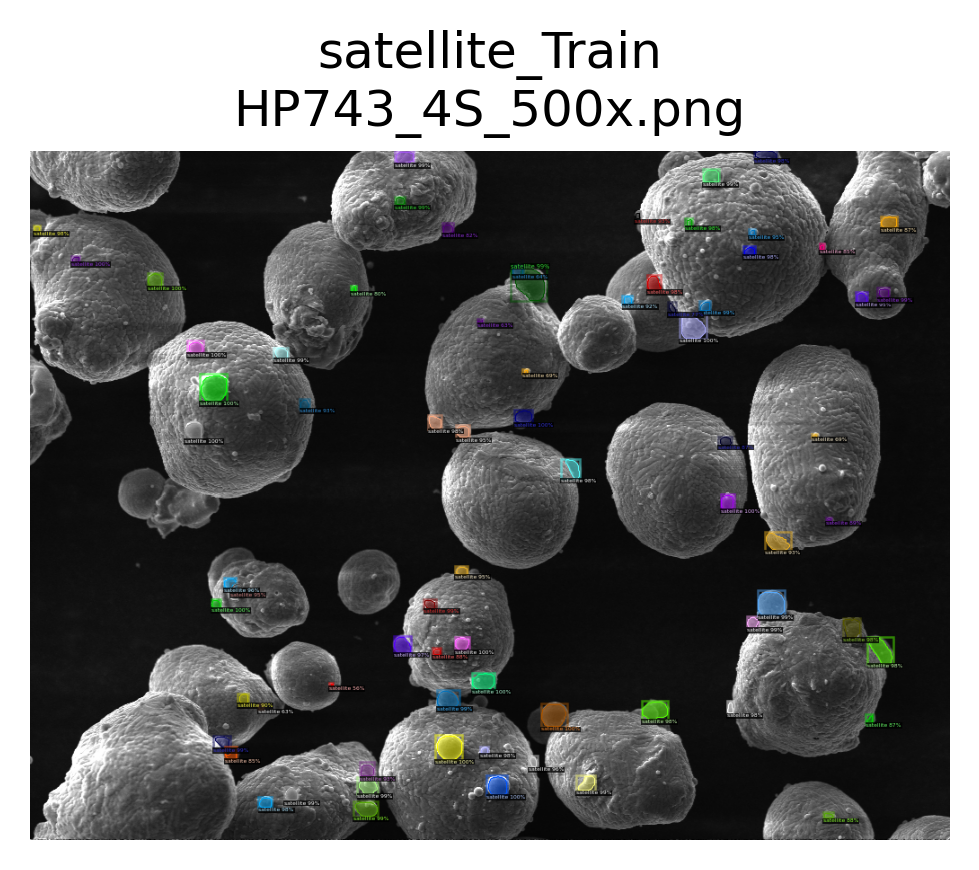

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_4S_500x.png
	num_instances: 74
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_500x.png


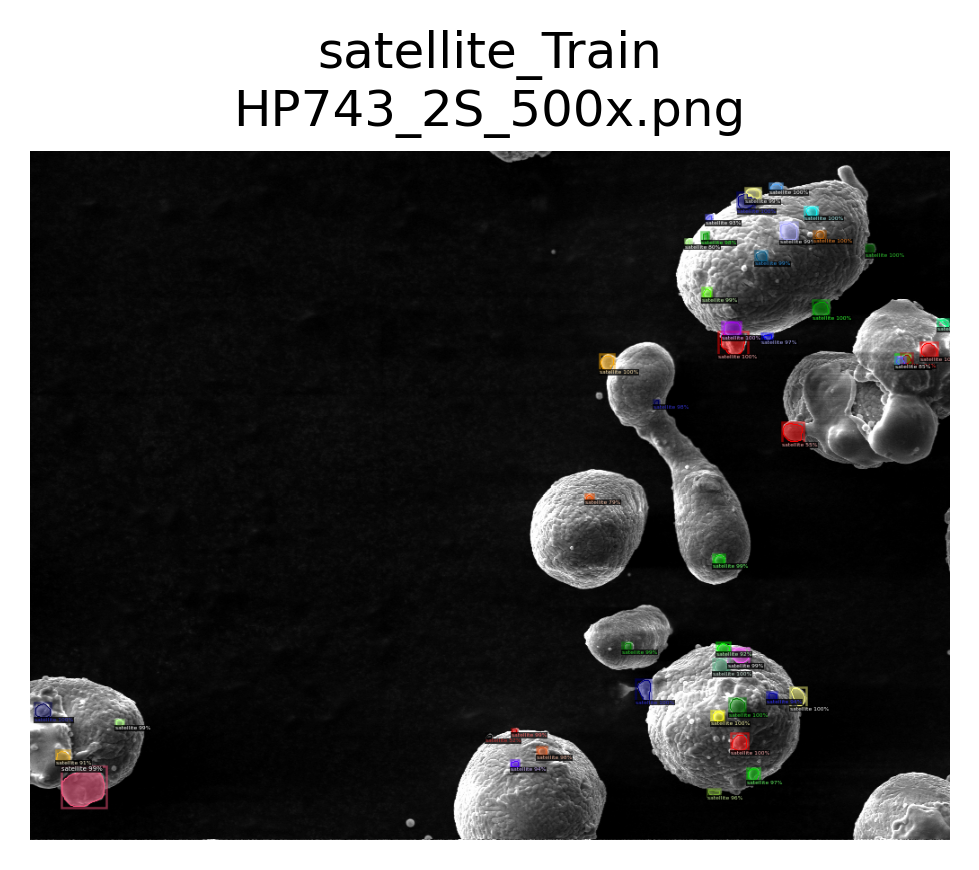

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_500x.png
	num_instances: 46
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_500x.png


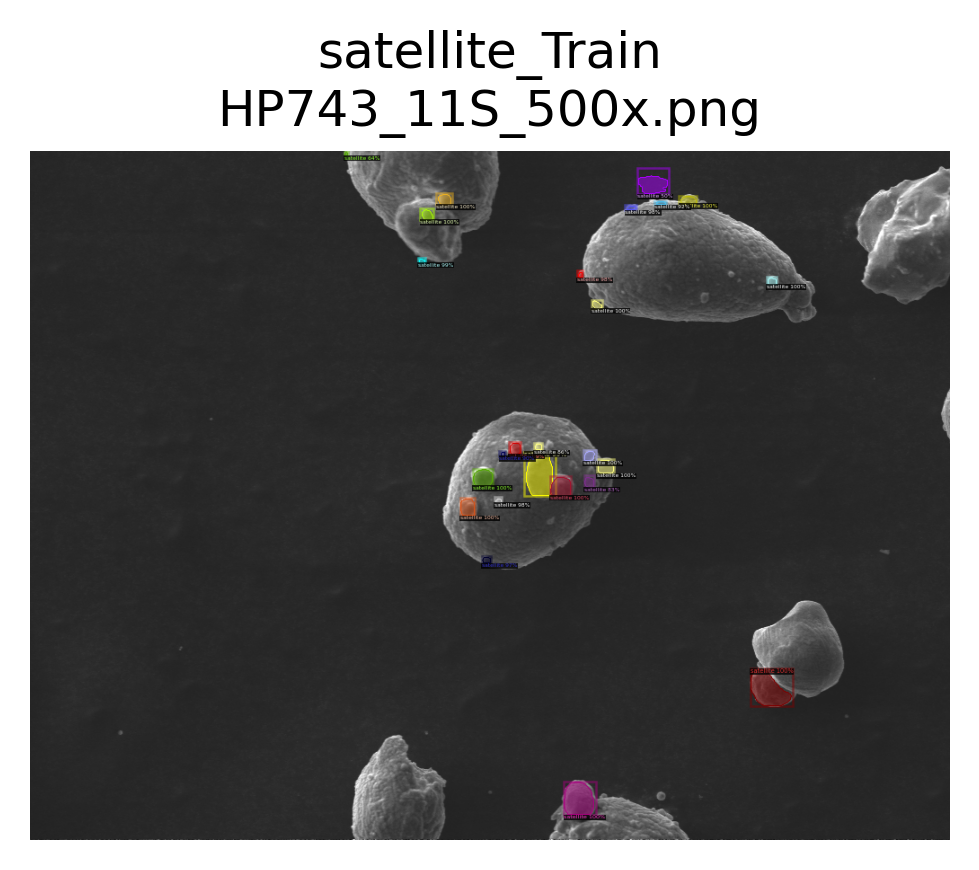

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_500x.png
	num_instances: 25
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_10S_500x.png


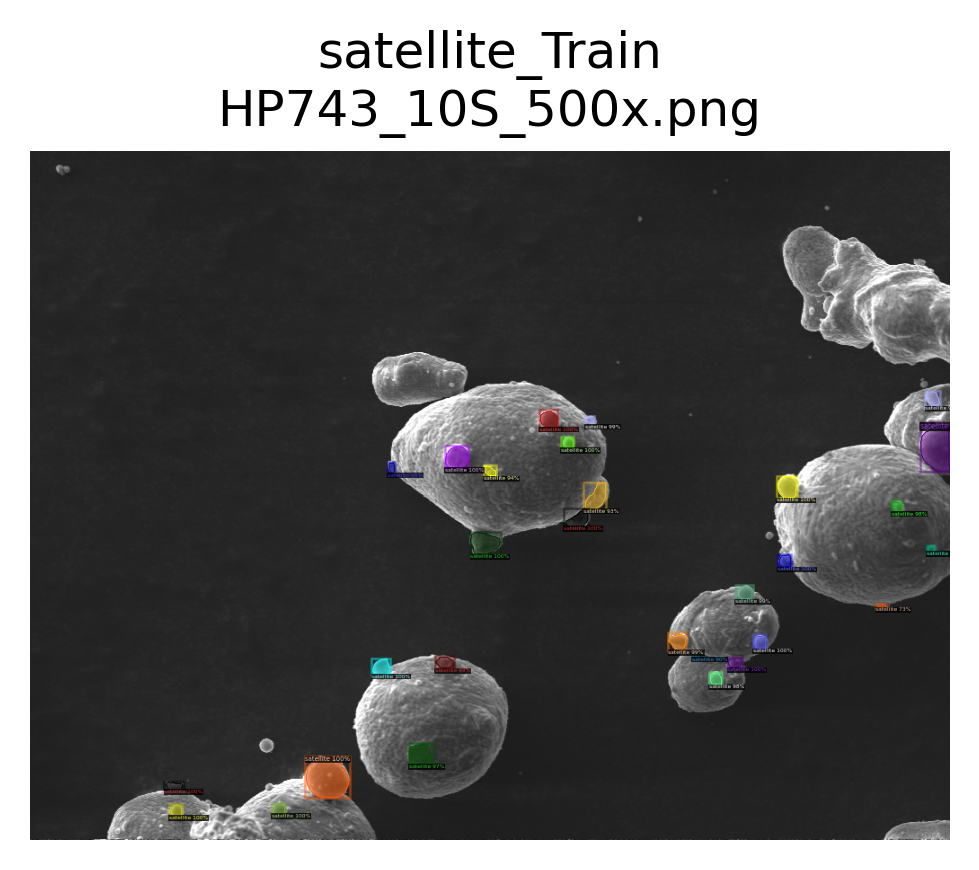

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_10S_500x.png
	num_instances: 29
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_12S_500x.png


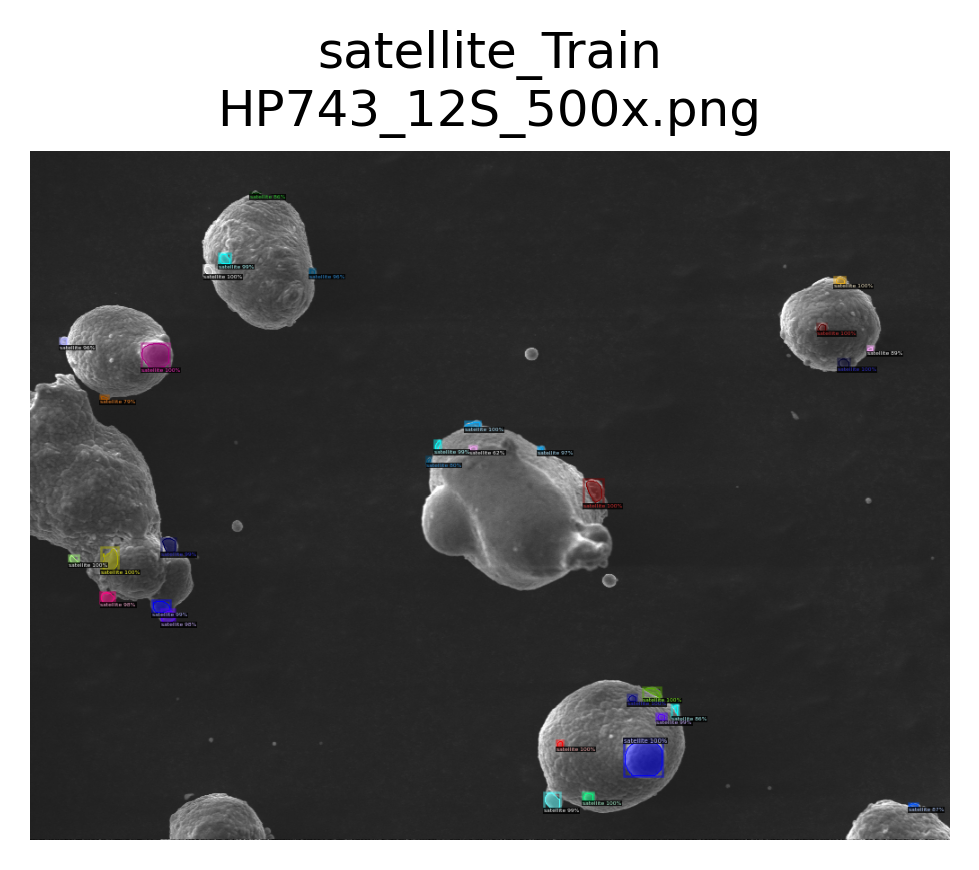

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_12S_500x.png
	num_instances: 32
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_3S_500x.png


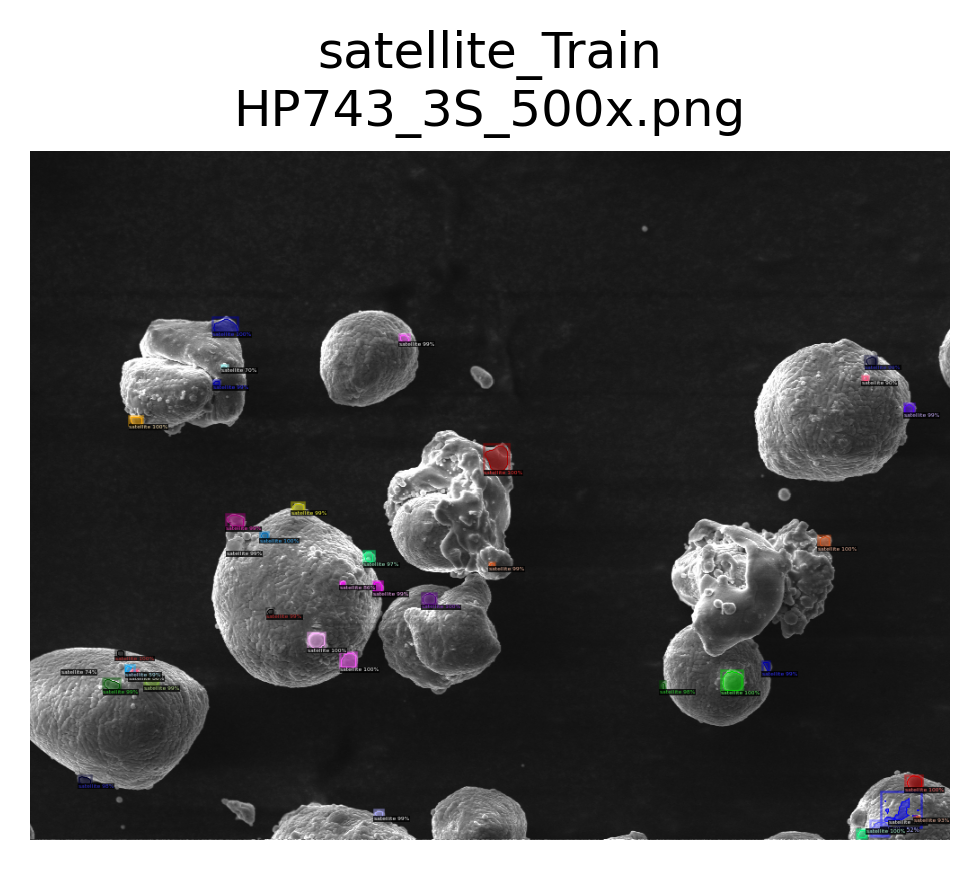

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_3S_500x.png
	num_instances: 38
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_1S_500x.png


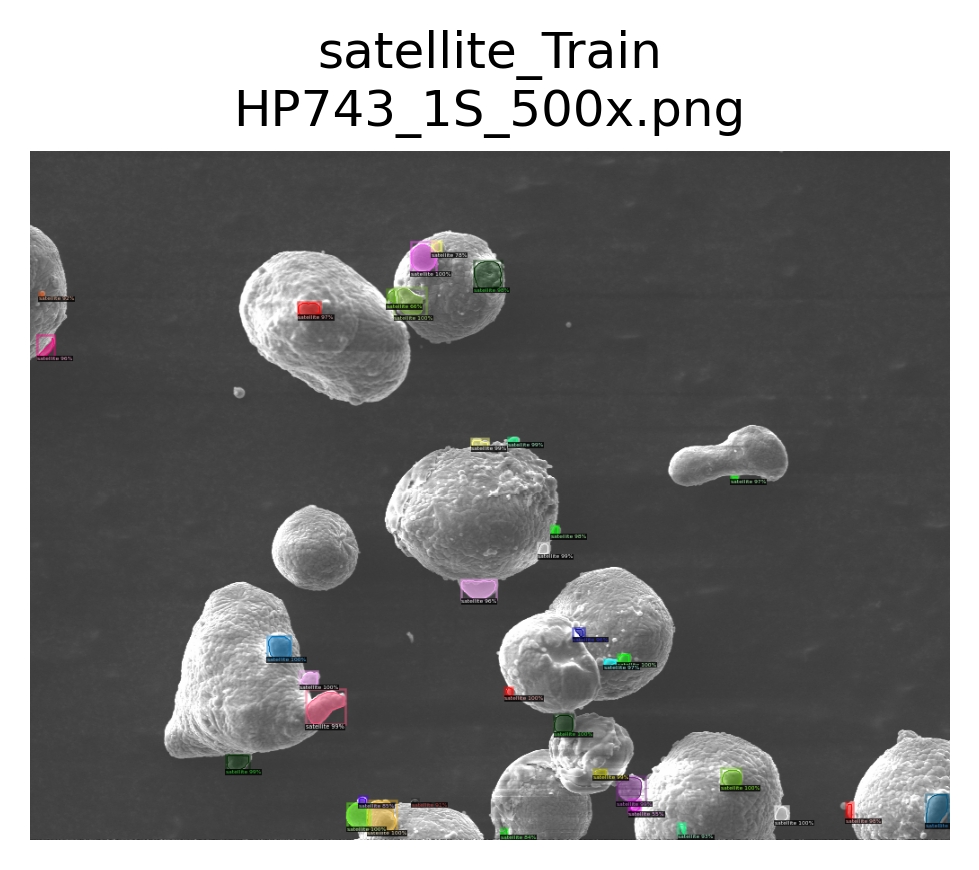

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_1S_500x.png
	num_instances: 36
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_5S_500x.png


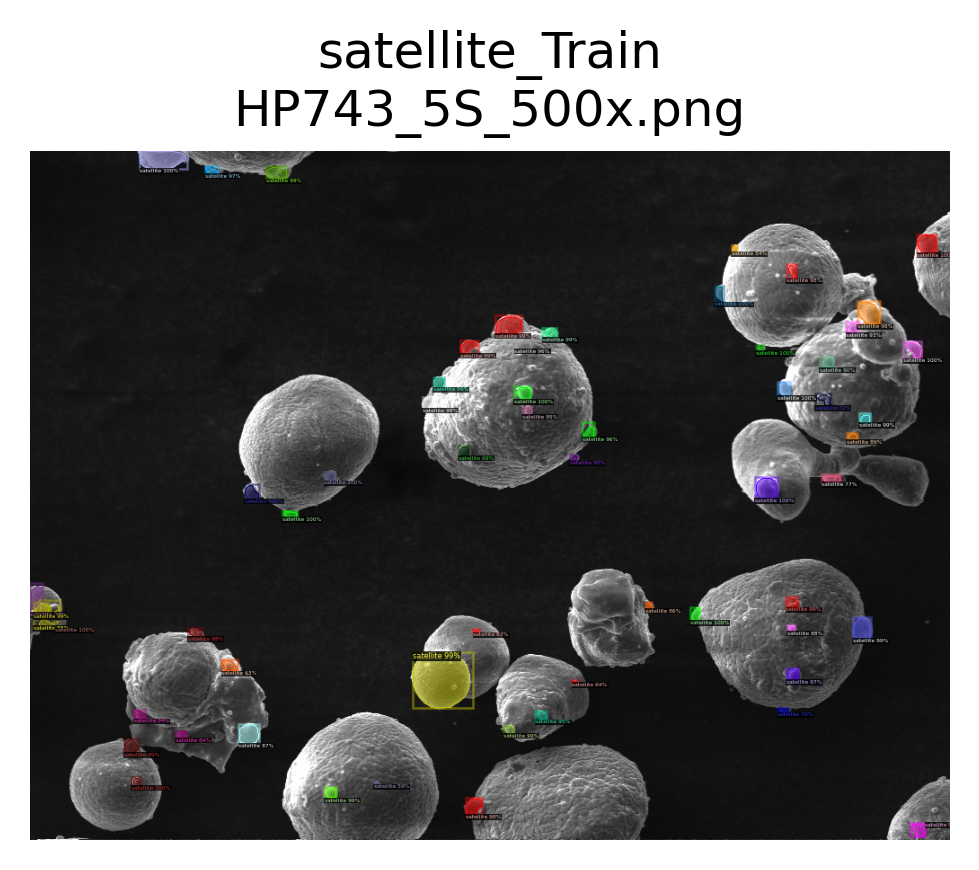

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_5S_500x.png
	num_instances: 59
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_02_SE1_1250X35.png


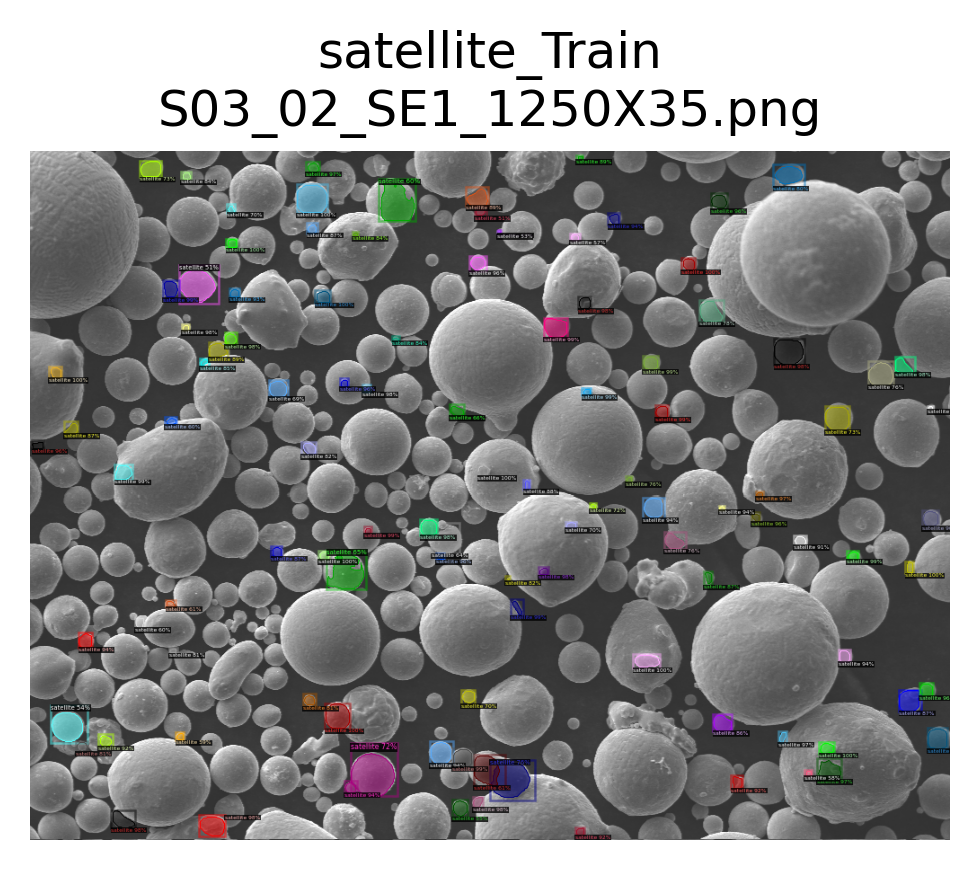

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_02_SE1_1250X35.png
	num_instances: 108
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_01_SE1_1250X28.png


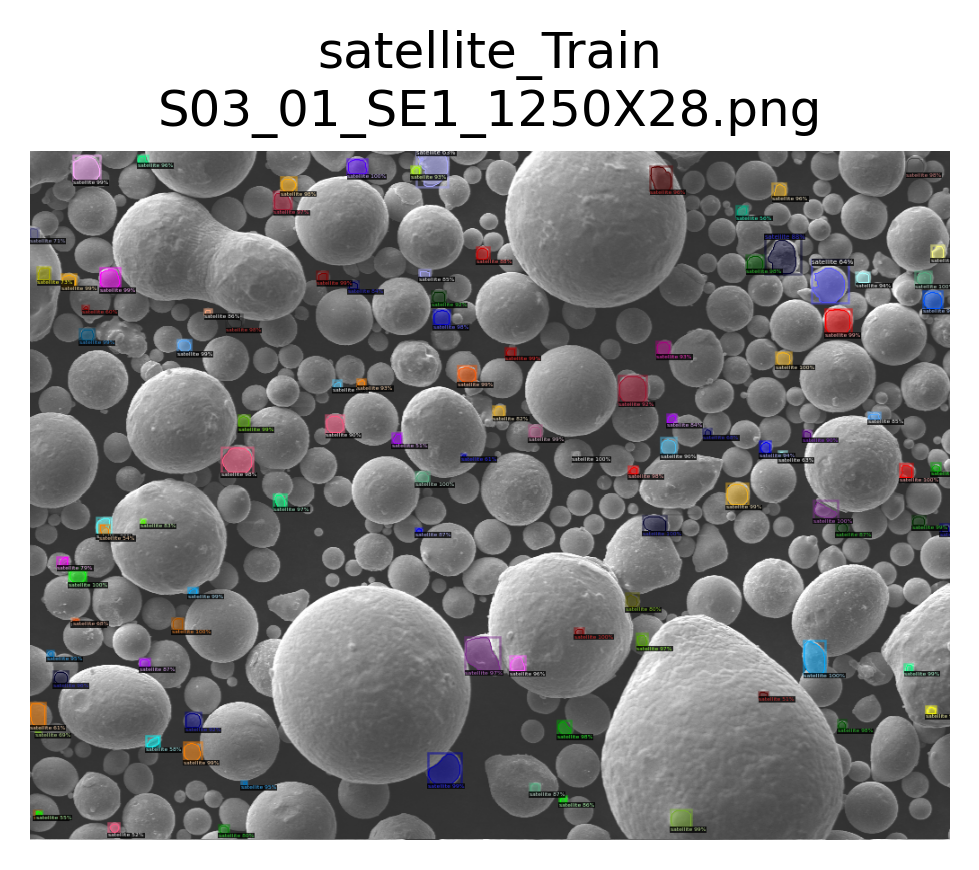

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_01_SE1_1250X28.png
	num_instances: 105
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_02_SE1_500X71.png


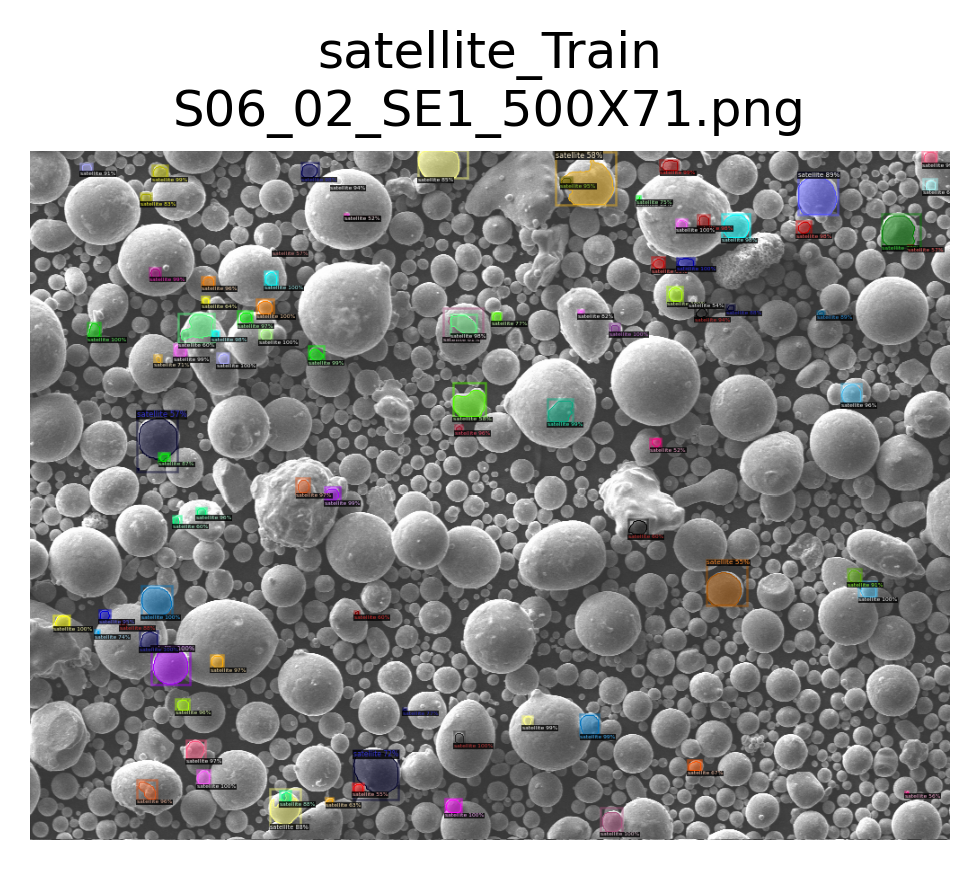

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_02_SE1_500X71.png
	num_instances: 90
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_03_SE1_500X75.png


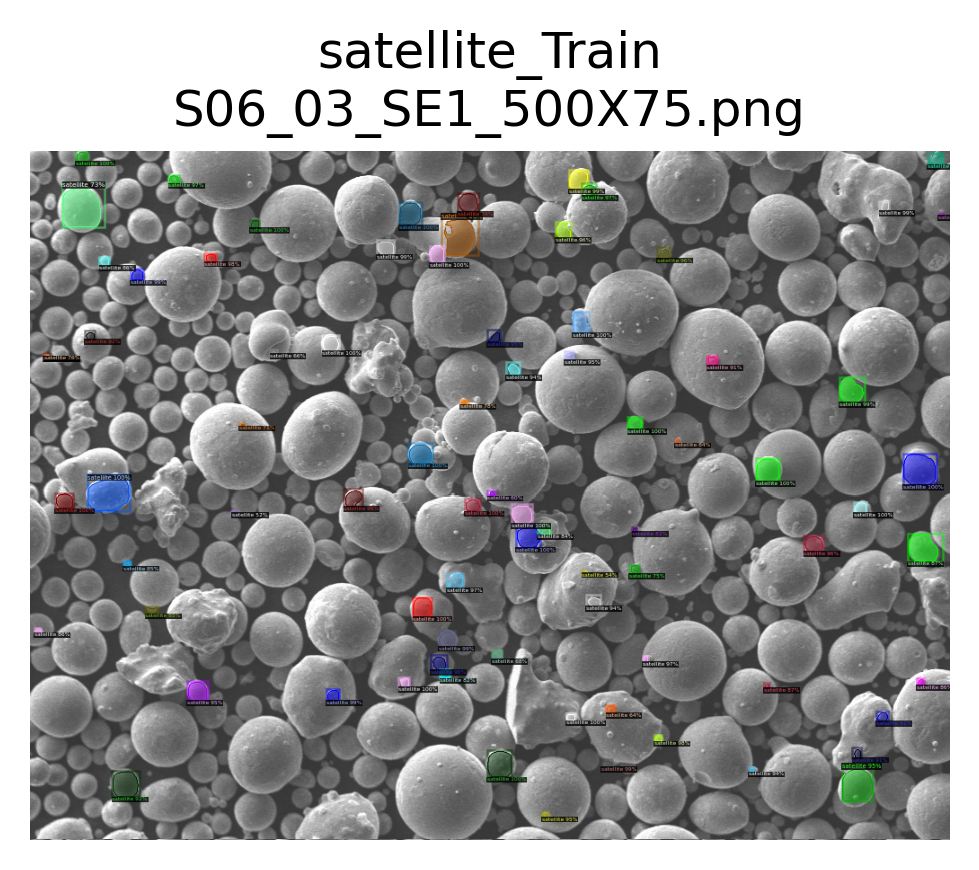

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_03_SE1_500X75.png
	num_instances: 80
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_02_SE1_300X18.png


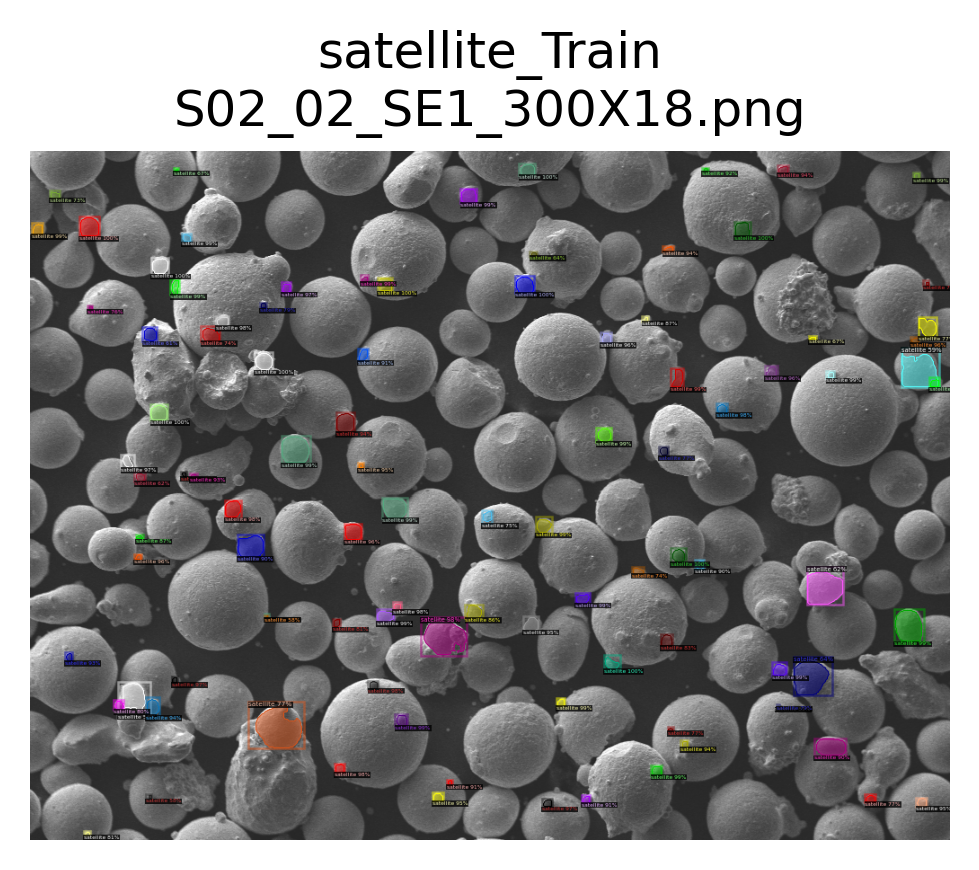

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_02_SE1_300X18.png
	num_instances: 98
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_03_SE1_300X22.png


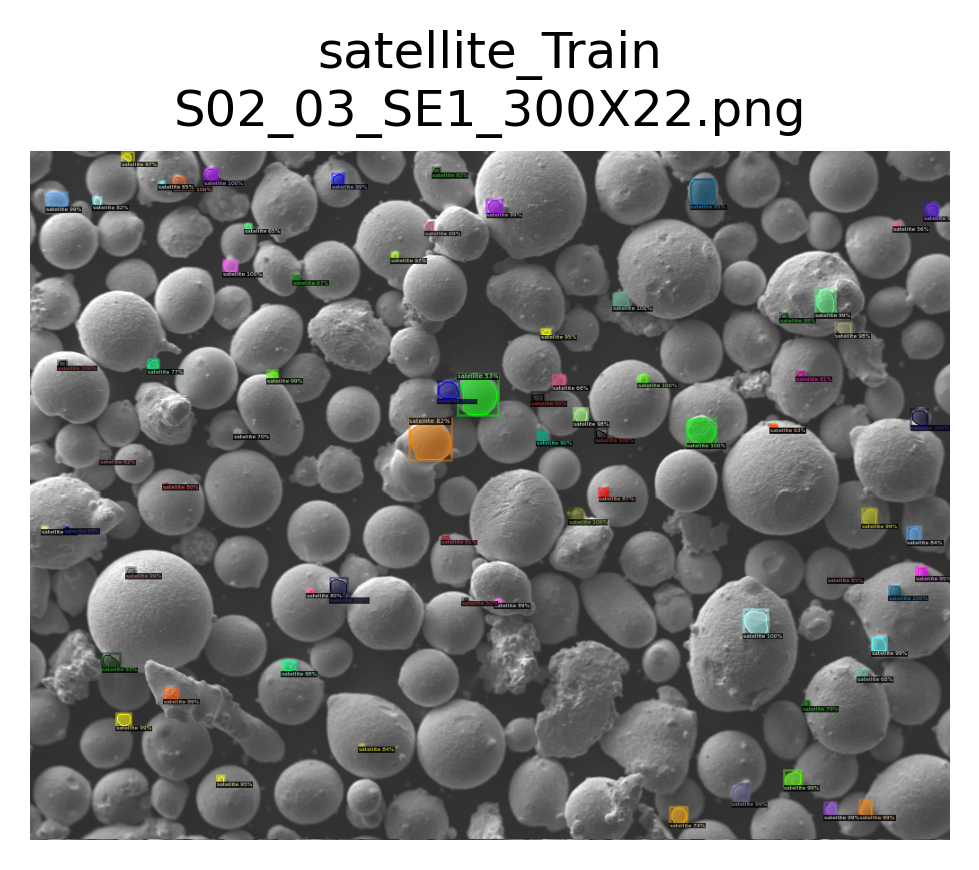

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_03_SE1_300X22.png
	num_instances: 72
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_250x.png


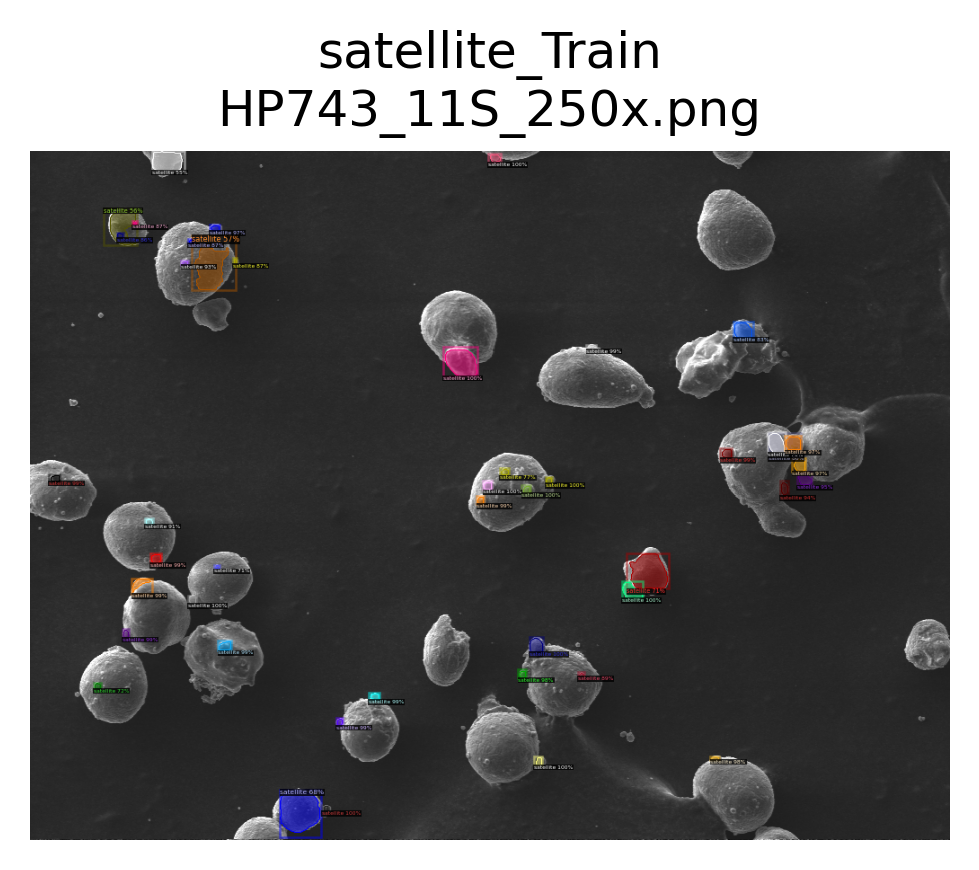

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_250x.png
	num_instances: 45
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_6S_250x.png


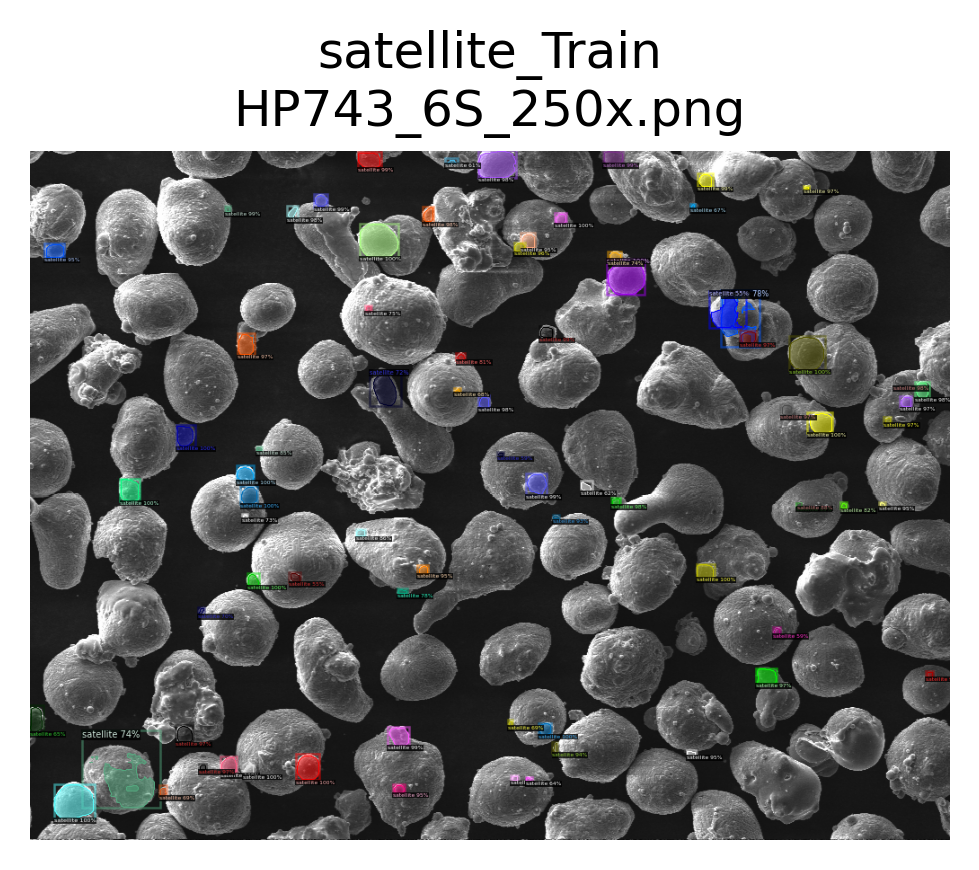

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_6S_250x.png
	num_instances: 77
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_02_SE1_1000X99.png


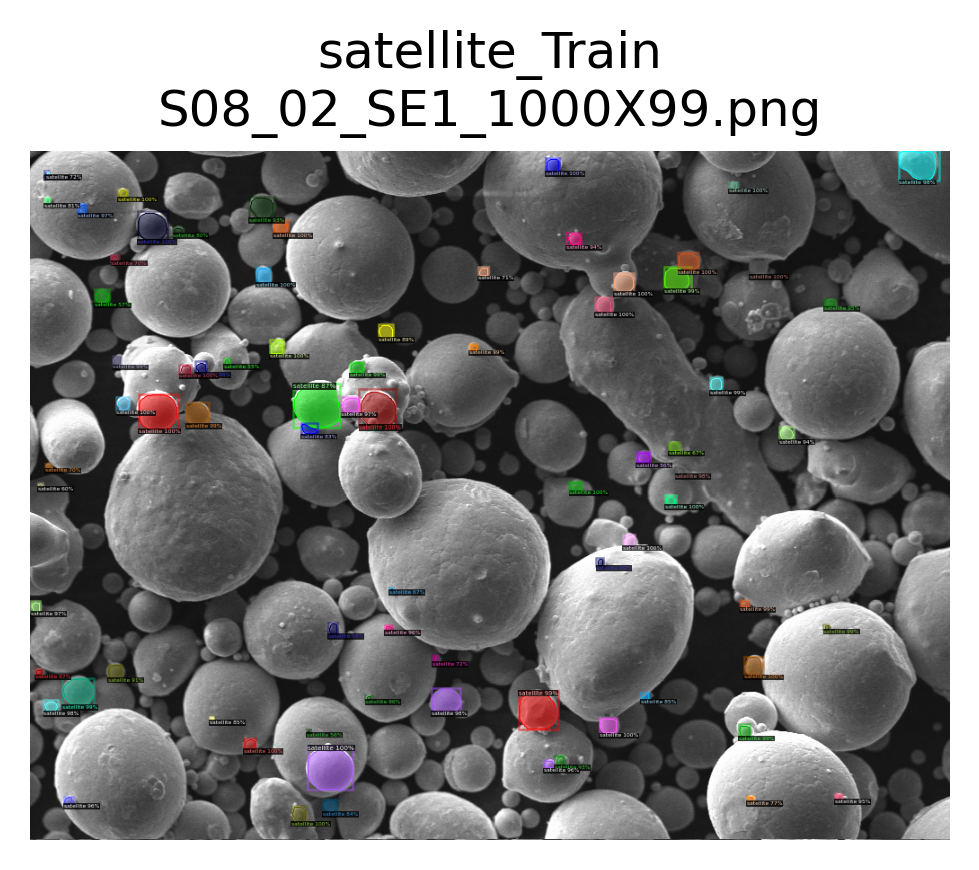

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_02_SE1_1000X99.png
	num_instances: 78
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_01_SE1_1000X94.png


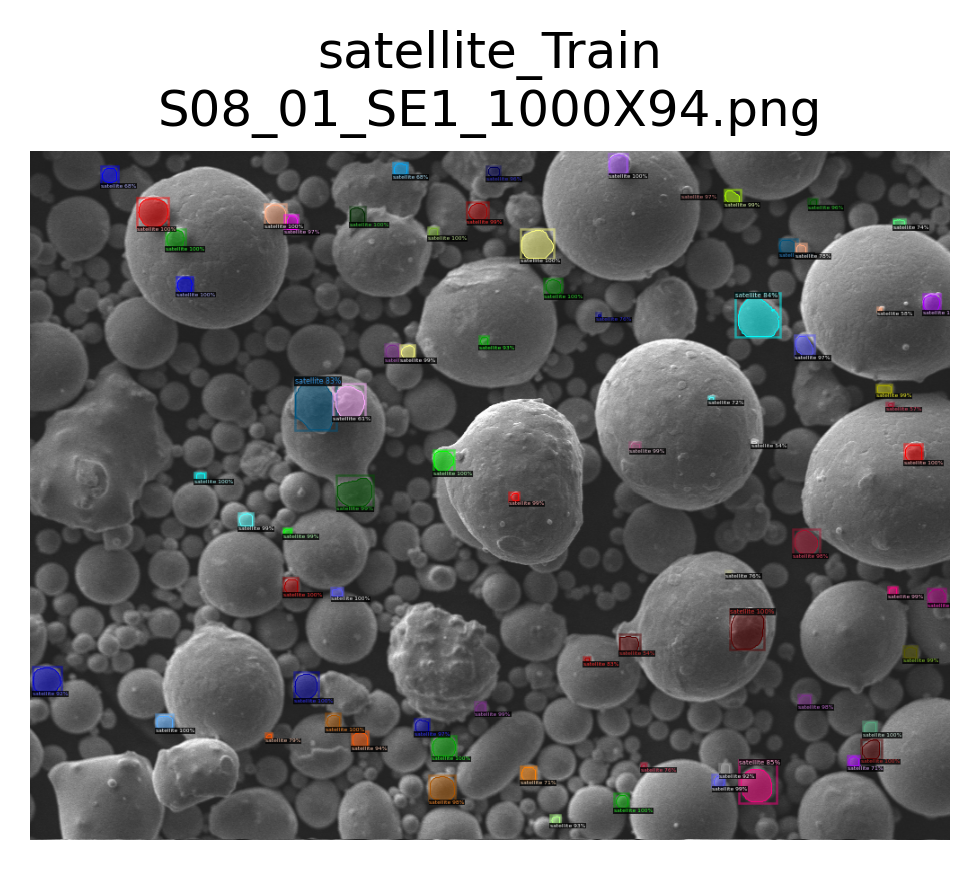

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_01_SE1_1000X94.png
	num_instances: 73
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png


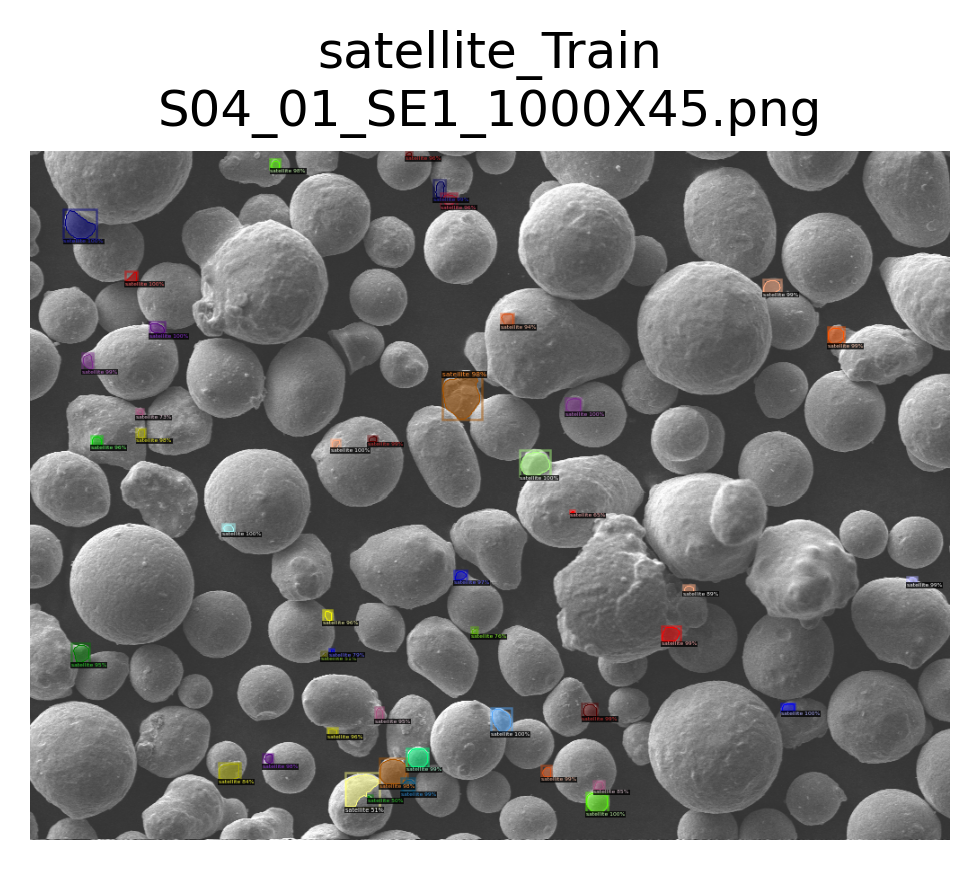

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png
	num_instances: 45
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_03_SE1_1000X53.png


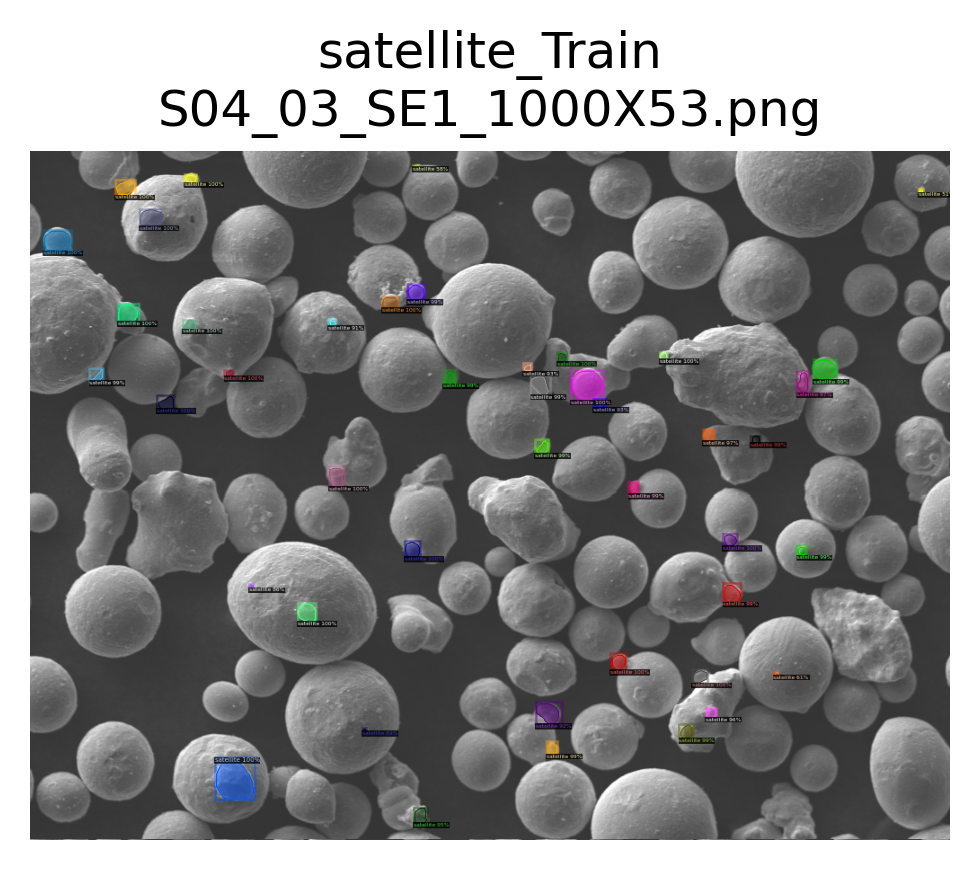

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_03_SE1_1000X53.png
	num_instances: 44
Dataset: satellite_Val
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png


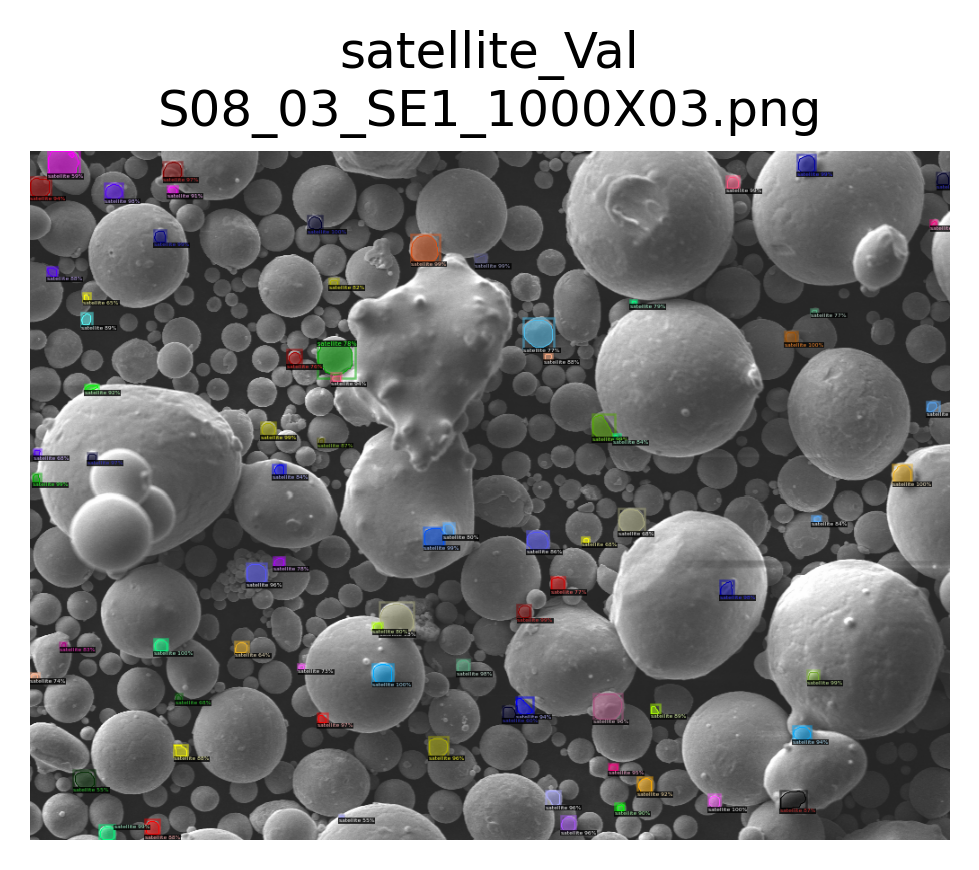

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png
	num_instances: 77
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png


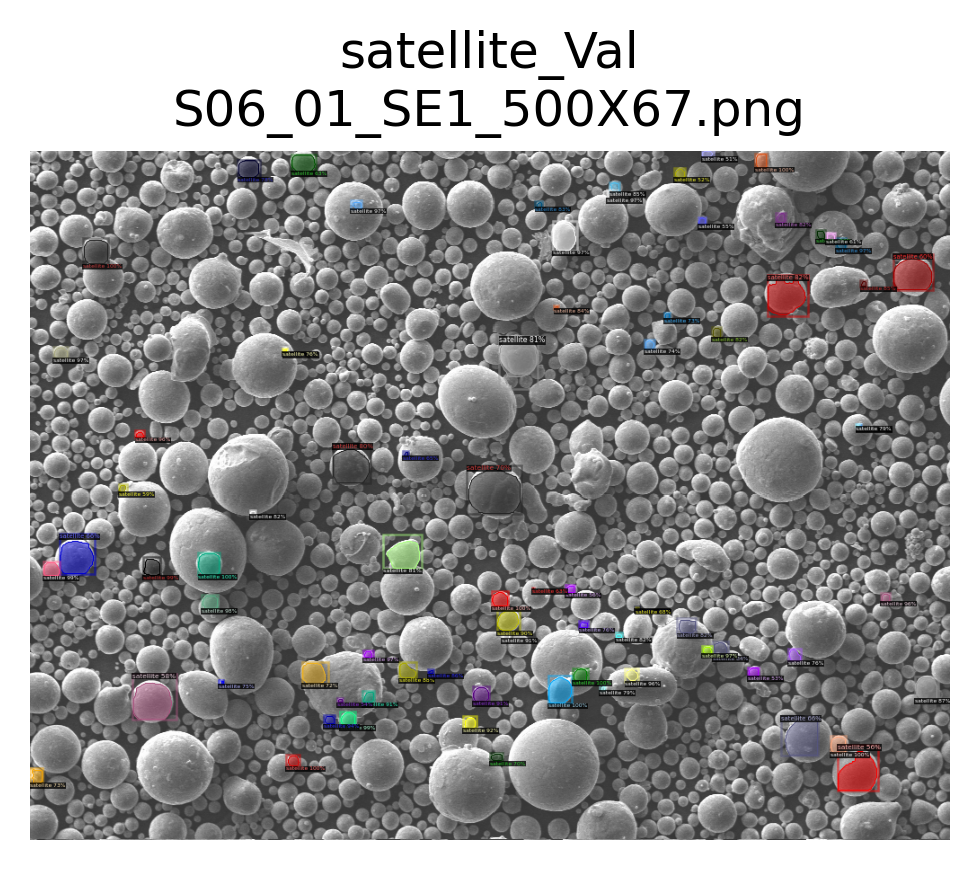

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png
	num_instances: 79
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png


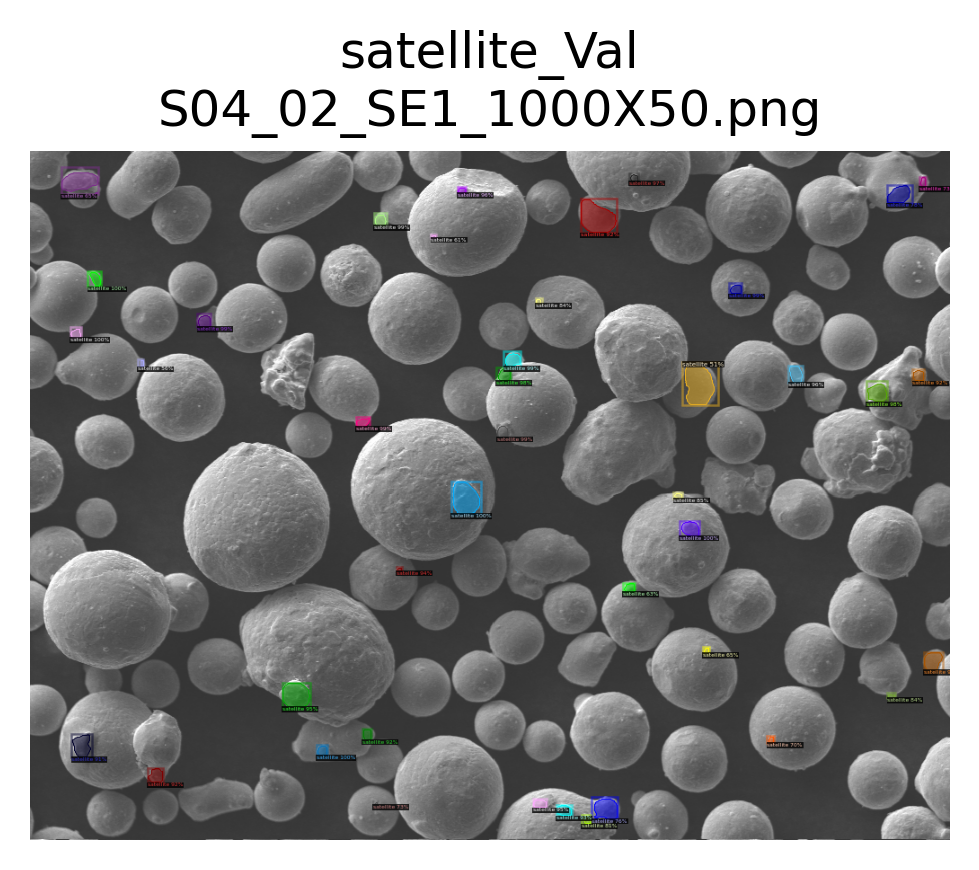

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png
	num_instances: 41
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png


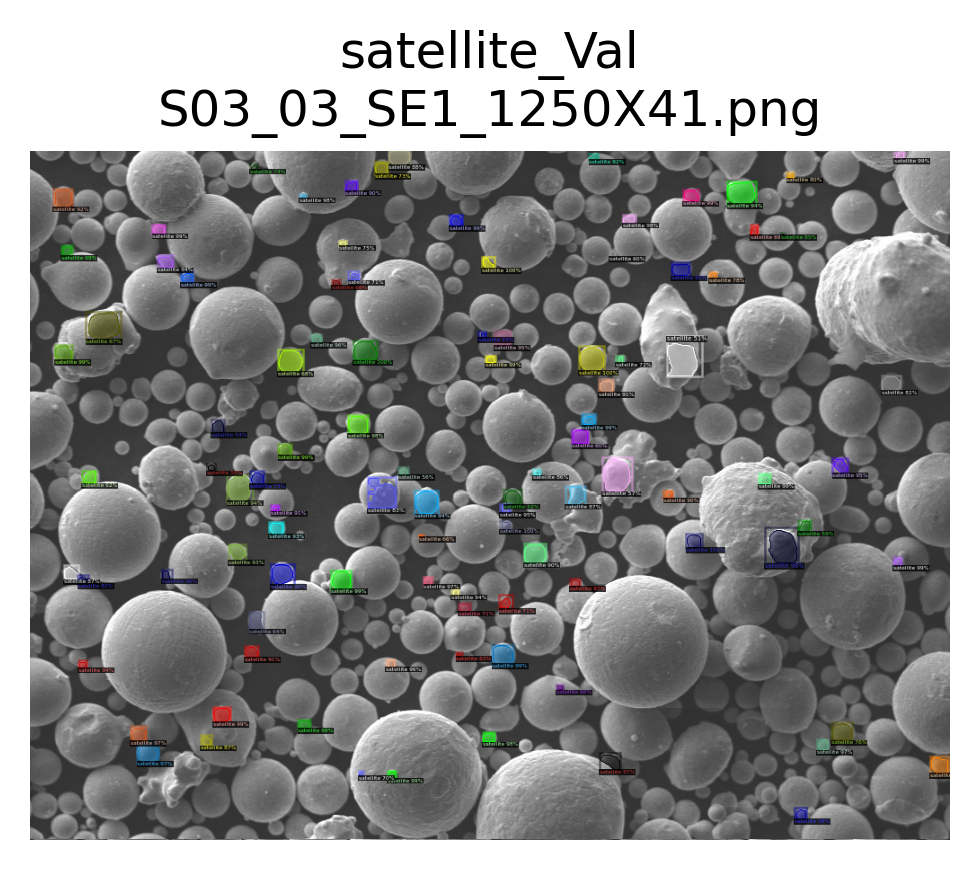

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png
	num_instances: 99
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png


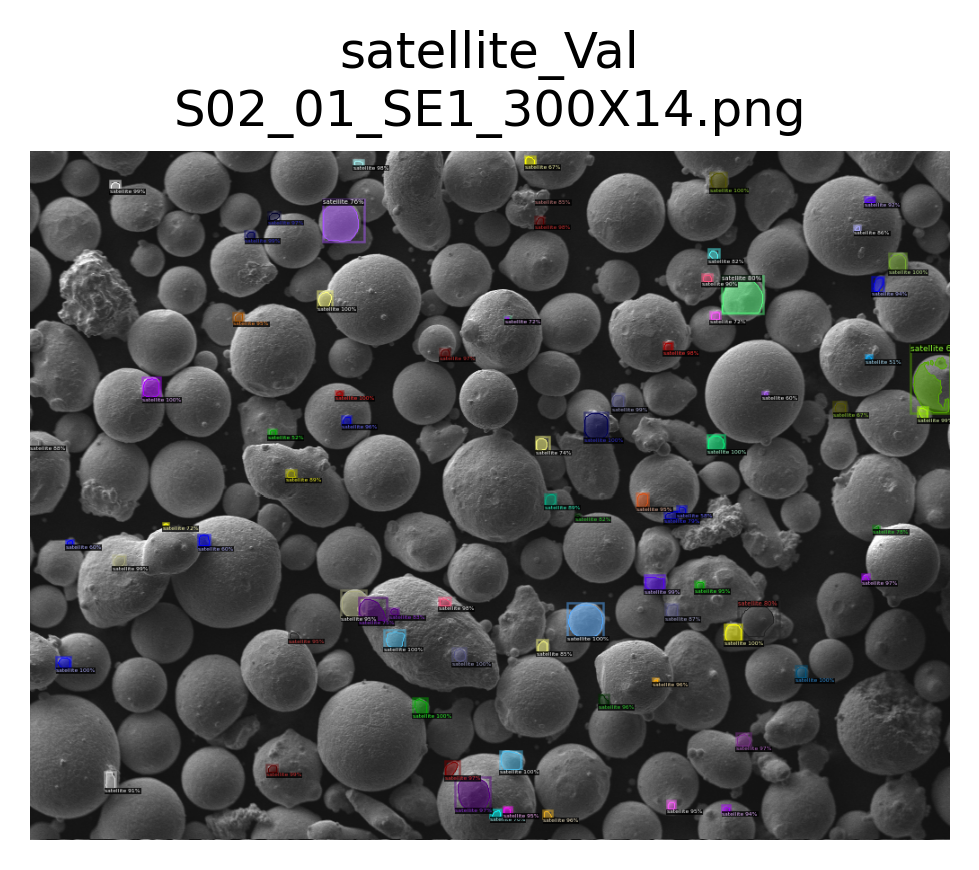

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png
	num_instances: 79
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png


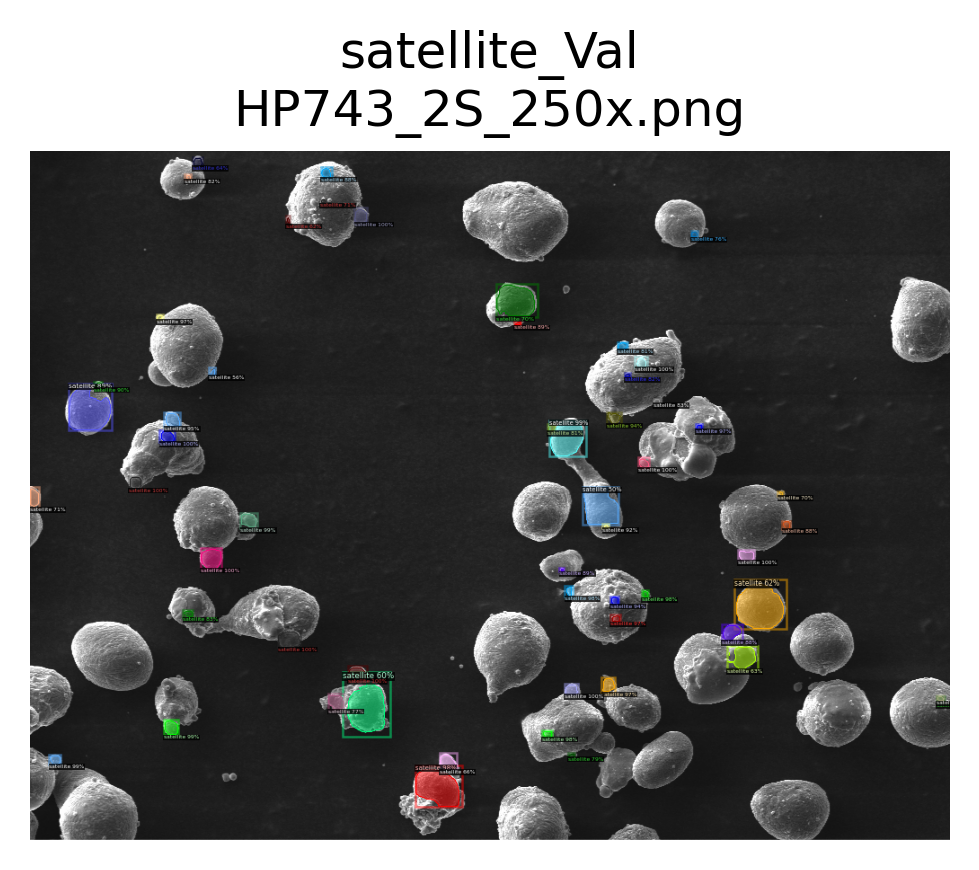

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png
	num_instances: 56


In [20]:
results = []
for ds in cfg.DATASETS.TEST:
    print(f'Dataset: {ds}')
    for dd in DatasetCatalog.get(ds):
        print(f'\tFile: {dd["file_name"]}')
        img = cv2.imread(dd['file_name'])  # load image
        outs = predictor(img)  # run inference on image
        
        # format results for visualization and store for later
        results.append(data_utils.format_outputs(dd['file_name'], ds, outs))

        # visualize results
        visualize.display_ddicts(outs, None, ds, gt=False, img_path=dd['file_name'])

# save to disk
#with open(Path('Stage_results',f'{EXPERIMENT_NAME}-base_stage.pickle'), 'wb') as f:
#    pickle.dump(results, f)

## Generating predictions on new images is simple.
We will load a new image (not included in either dataset) and generate predictions.
Note that we do not have labels for this image and do not need to register it to a dataset.

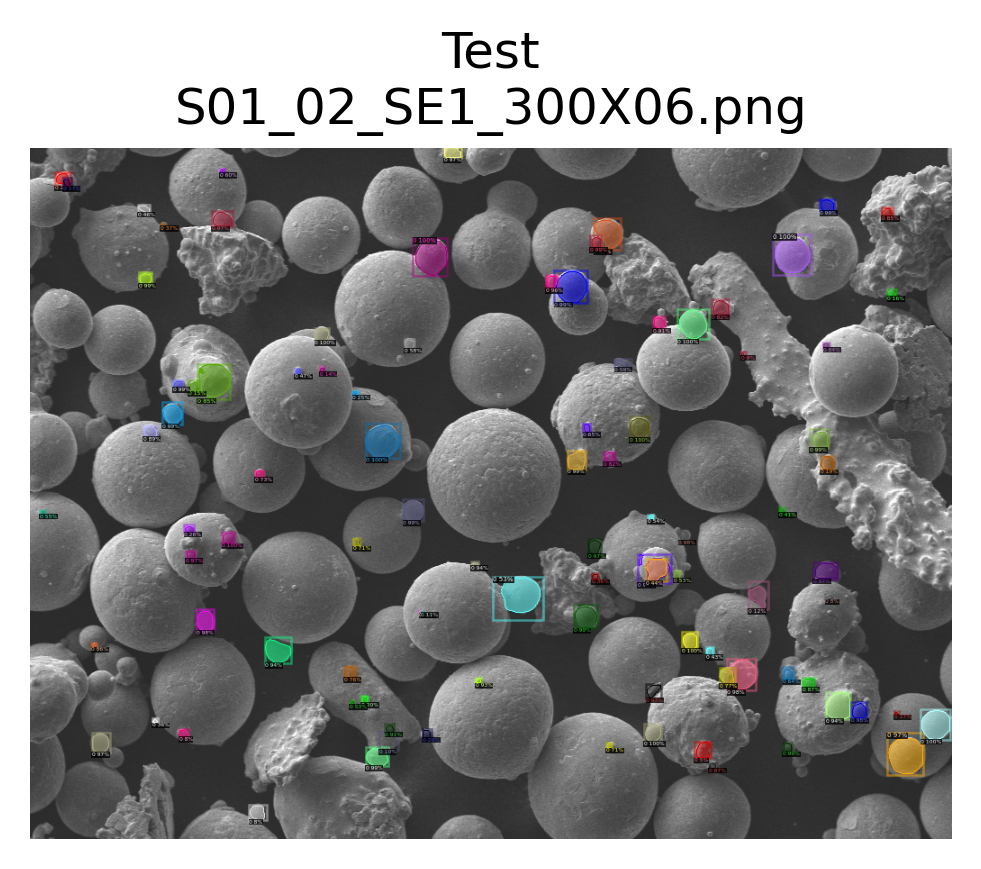

ddict info:
	path: ../data/SEM/S01_02_SE1_300X06.png
	num_instances: 95


In [11]:
img_path = Path('..', 'data','SEM', 'S01_02_SE1_300X06.png')
img = cv2.imread(str(img_path))
outs = predictor(img)
data_utils.format_outputs(img_path, dataset='test', pred=outs)
visualize.display_ddicts(ddict=outs,  # predictions to display
                                 outpath=None, dataset='Test',  # don't save figure
                                 gt=False,  # specifies format as model predictions
                                img_path=img_path)  # path to image
